In [56]:
# Only run if you need specific libraries when using jupyter
# !pip install pandas
# !pip install numpy
# !pip install spacy
# !pip install demoji
# !pip install fasttext
# !pip install requests
# !pip install tqdm
# !pip install sklearn
# !pip install "gensim>=4.0.0"

In [123]:
# Imports

# Data access, editing and management
import pandas as pd
import numpy as np
import sqlite3
# POS extraction and tokenization
import spacy
import regex as re
import demoji
# Language identification for tokens
import fasttext
import requests
# Processing time visualization
from tqdm import tqdm
tqdm.pandas()
# To run console commands for installation
import os
# For vectorization and clustering
from sklearn.feature_extraction.text import TfidfVectorizer
from spacy.lang.en.stop_words import STOP_WORDS as stop_words
from gensim.models import Word2Vec
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
# Wordcloud analysis and visualization
import wordcloud as wc
import matplotlib.pyplot as plt
from datetime import datetime

# Extract DF from part 1

In [58]:
# Extracting articles df
df = pd.read_pickle('articles.pkl')
# df

# Function to save data during checkpoints

In [163]:
# Function to store data at this checkpoint after formatting body_text
def save_files(df, name):
    df.to_pickle(f'{name}.pkl')

    sql = sqlite3.connect(f'{name}.db')
    df.to_sql(name, sql, if_exists='replace')
    sql.close()

# Filter DF to only show as much relevant data as possible, eliminating files with errors, empty strings, and no content

In [59]:
# Filter out bad request or any empty body data on the df

# Remove articles that do not have any text - run only once to not cause error
df = df.loc[df['body_text'] != '']
df.loc[df['body_text'] == '']

,title,author,publication,body_text,url,state


In [60]:
# Get rid of any nan values in body and title
a = df.loc[~df['title'].isnull()]
df = a
b = a.loc[~a['body_text'].isnull()]
df = b

In [61]:
df.loc[df['body_text'].isnull()]

,title,author,publication,body_text,url,state


In [62]:
# Remove any 403 error files
a = df.loc[(~df['title'].str.contains('403')) & (~df['url'].isnull())]
b = a.loc[(~a['title'].str.contains('Forbidden')) & (~a['url'].isnull())]
df = b
b.loc[df['title'].str.contains('Forbidden')]

,title,author,publication,body_text,url,state


In [63]:
# Reset index after performing first cleanup
df = df.reset_index(drop=True)

In [165]:
'''
Make and filter df function call for convenience of user to use application
All actions on blocks above being performed in one call

    params: none
    returns: df filtered
'''
def make_filter_df():
    # Extracting articles df
    df = pd.read_pickle('articles.pkl')
    
    # Remove articles that do not have any text - run only once to not cause error
    df = df.loc[df['body_text'] != '']
    
    # Remove any 403 error files - assignments done to avoid issues with slicing dataframe
    a = df.loc[(df['title'].str.contains('403')) & (df['url'].isnull())]
    mask = ~df.index.isin(a.index)
    b = df.loc[mask]
    
    a = b.loc[(b['title'].str.contains('Forbidden')) & (b['url'].isnull())]
    mask = ~b.index.isin(a.index)
    c = b.loc[mask]
    df = c

    # Reset index after performing first cleanup
    df = df.reset_index(drop=True)

    return df

In [166]:
# Call function above for when walking through notebook
df = make_filter_df()

# Clean up text data to ensure POS tokens significance can be extracted properly by spacy

In [150]:
'''
Function to remove any emojis in text
'''
def remove_emojis(text):
    # Get emoji codes from library demoji
    demoji.download_codes()
    
    dem = demoji.findall(text)
    for item in dem.keys():
        text = re.sub(item, '', text)
    return text

In [151]:
# Function to clean unprocessed text body from each article
def clean_text(text):
    # Remove emojis
    text = remove_emojis(text)
    # Remove any solo numbers in line
    text = re.sub(r'^[0-9]+\s.*', '', text, flags=re.MULTILINE)
    # Replace multiple spaces with one
    text = re.sub(' +', ' ', text)
    # Replace multiple newlines by splitting string into substrings saved in a list
    text = re.split('\s*\n\s*\n', text)
    text = [item for item in text if len(re.split(' ', item)) > 5]
    # Join all vals in list as a one string again
    text = " ".join(text)
    # Replace newline characters left with single space
    text = re.sub('\n', ' ', text)
    # Return cleaned text string
    return text

In [ ]:
# Clean text within column 'body_text' in dataframe df
# df['body_text'] = [clean_text(text) for text in df['body_text']]
df['body_text'] = [clean_text(text) for text in df['body_text']]

In [68]:
df.head(3)

,title,author,publication,body_text,url,state
0,Tornadoes severe weather updates: 26 dead in M...,None,None,Start the day smarter How often do women givin...,https://www.usatoday.com/story/news/nation/202...,Mississippi
1,Fatality confirmed in Vermont flooding amid ex...,ABC News,None,ABC NewsVideoLiveShowsElectionsInterest Succe...,https://abcnews.go.com/US/tornadoes-midwest-fl...,Illinois
2,Terrifying moment monster tornado rips apart A...,Aneeta Bhole,None,US women spark fury with ANOTHER listless rend...,https://www.dailymail.co.uk/news/article-11926...,Arkansas


## Store df as pickle - intermediary step

In [ ]:
save_files(dft, 'articles_cleaned')

# Tokenization and POS tagging via Spacy

## Language detection function to ensure all tokens will be properly tagged based on the english language via fasttext

In [70]:
# Download from web the model for language detection from fasttext
model_filename = "lid.176.ftz"
r = requests.get(f"https://dl.fbaipublicfiles.com/fasttext/supervised-models/{model_filename}")
open(model_filename, 'wb').write(r.content)
# load language identification model 
lang_model = fasttext.load_model(model_filename)

In [205]:
'''
Function that detects if a text contains a great quantity of tokens in another language,
if it does, it is removed from our sample, but if it is below the threshold, we do not remove
the words due to the fact that natural disasters often use name of locations in the U.S. that
are rooted in words from other languages.

    params:     doc => text string

    returns:    boolean => indicates if document passes language check
'''
def detect_language(lang_model, doc):

    # Temporarily remove newline symbols due to function format requirements
    text = doc.replace("\n", " ")
    # Set desired language
    correct = "en"
    doc_l = lang_model.predict(text, k=2)
    # If first label is english and english label is highest value of two found languages
    if (doc_l[0][0].replace("__label__", "") == "en" and doc_l[1][0] > 2*doc_l[1][1]) or (doc_l[0][1].replace("__label__", "") == "en" and doc_l[1][1] > doc_l[1][0]):
        # Confirm to use text
        return True

        # In case we wish to proceed to evaluate tokens and extract unnecessary non-english words
        # # Create flag
        # ok = not_ok = 0
        # # Perform individual token checks via fasttext
        # for token in tokens:
        #     l = lang_model.predict(token, k=2)
        #     # If percentage in english is greater than twice the percentage of other language
        #     if l[1][0] > 2*l[1][1]):
        #         # Simplify label to language abbreviation
        #         predict = l[0][0].replace("__label__", "")
        #         # If extracted language result is English
        #         if predict == correct:
        #             ok += 1
        #         else:
        #             print(f"Error at '{text}'")
        #             print(f"should be {correct}, predicted {predict} ")
        #             not_ok += 1

        #     print(f"ok = {ok}, not ok = {not_ok}")
    else:
        # Indicate document is in another language mostly and won't be adecuate to be used for k-means
        return False

## Part of Speech(POS) tagging function to Find and store into DF POS via spacy

In [72]:
# Install spacy module via jupyter notebook only
!python3 -m spacy download en_core_web_lg

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 587.7/587.7 MB 4.5 MB/s eta 0:00:0000:0100:02
✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [154]:
'''
Function to assign POS types into df
    params: text of document
    returns: 5 lists containing tokens
''' 
def word_types(doc):
    # Variables to store tokens
    nouns = []
    adjectives = []
    verbs = []
    lemmas = []
    nav = []
    
    for token in doc:
        lemmas.append(token.lemma_)
        # adjectives (and adverbs)
        if token.pos_ == "ADJ": #or token.pos_ == "ADV":
            adjectives.append(token.lemma_)
            nav.append(token.lemma_)
        # nouns
        if token.pos_ == "NOUN" or token.pos_ == "PROPN":
            nouns.append(token.lemma_)
            nav.append(token.lemma_)
        # verbs
        if token.pos_ == "VERB" or token.pos_ == "AUX":
            verbs.append(token.lemma_)
            nav.append(token.lemma_)
            
    return (nouns, adjectives, verbs, nav, lemmas)

## Main tokenization and tagging function

In [207]:
# Navigate through each row to set POS tags in corresponding locations
def pos_tagging(a:pd.DataFrame):
    # Download from web the model for language detection from fasttext
    model_filename = "lid.176.ftz"
    r = requests.get(f"https://dl.fbaipublicfiles.com/fasttext/supervised-models/{model_filename}")
    open(model_filename, 'wb').write(r.content)
    # load language identification model 
    lang_model = fasttext.load_model(model_filename)

    # Install spacy module by running through os library in terminal/console
    os.system("python3 -m spacy download 'en_core_web_lg'")

    # Create Spacy tokenizer based on downloaded language model in english
    nlp = spacy.load("en_core_web_lg")

    # Iterate through rows to get text of each row
    for index, row in a.iterrows():
        # Check if language is considered English
        l = detect_language(lang_model, row['body_text'])
        # If returns True because it is in English, perform tokenization
        if l: 
            # Use Spacy library to create tokens with text of document selected
            tokens = nlp(row['body_text'])
            # If produced tokens amount to greater than 30
            if len(tokens) >= 30:
                (nouns, adjectives, verbs, nav, lemmas) = word_types(tokens)
                a.at[index, 'nouns'] = "|".join(nouns)
                a.at[index, 'adjetives'] = "|".join(adjectives)
                a.at[index, 'verbs'] = "|".join(verbs)
                a.at[index, 'nav'] = "|".join(nav) # combinations
                a.at[index, 'lemmas'] = "|".join(lemmas)
                a.at[index, 'num_tokens'] = len(tokens)

In [75]:
# Temporary small df for testing
# a = df.copy(deep=True)
# a = a[:10]
# pos_tagging(a)
# a

In [76]:
# Function call for pos tagging extraction - averages 18 minutes of run
pos_tagging(df)

In [77]:
df.head(2)

,title,author,publication,body_text,url,state,nouns,adjetives,verbs,nav,lemmas,num_tokens
0,Tornadoes severe weather updates: 26 dead in M...,None,None,Start the day smarter How often do women givin...,https://www.usatoday.com/story/news/nation/202...,Mississippi,day|woman|birth|hospital|heart|attack|seizure|...,smart|individual|other|deadly|notable|severe|d...,start|do|give|experience|podcast|sell|topic'wi...,start|day|smart|do|woman|give|birth|individual...,start|the|day|smart|how|often|do|woman|give|bi...,2488.0
1,Fatality confirmed in Vermont flooding amid ex...,ABC News,None,ABC NewsVideoLiveShowsElectionsInterest Succe...,https://abcnews.go.com/US/tornadoes-midwest-fl...,Illinois,ABC|NewsVideoLiveShowsElectionsInterest|Succes...,aboutturn|extreme|nationwideExtreme|most|multi...,notify|break|confirm|flood|continue|affect|pas...,ABC|NewsVideoLiveShowsElectionsInterest|Succes...,|ABC|NewsVideoLiveShowsElectionsInterest|Succ...,998.0


## If in need to start off again but from after leaning and before tagging

In [78]:
# df = pd.read_pickle('articles_cleaned.pkl')

## Cleanup extended df from rows with no tags data and formatting issues

In [79]:
# Remove from df rows with empty cells in the POS tag columns
a = df.loc[~df['nouns'].isnull()]
df = a
# Reset index
df = df.reset_index(drop=True)

In [80]:
# Check if any null values still contained
df.loc[df['nouns'].isnull()]

,title,author,publication,body_text,url,state,nouns,adjetives,verbs,nav,lemmas,num_tokens


In [81]:
# Output df
df.sample(3)

,title,author,publication,body_text,url,state,nouns,adjetives,verbs,nav,lemmas,num_tokens
2034,1 killed and almost 2 dozen injured in overnig...,"Nouran Salahieh,Rob Shackelford",None,1. How relevant is this ad to you? 2. Did yo...,https://www.cnn.com/2023/06/19/weather/severe-...,Mississippi,ad|issue|video|player|content|ad|video|content...,relevant|technical|slow|loud|repetitive|overni...,be|do|encounter|be|load|freeze|do|finish|load|...,relevant|be|ad|do|encounter|technical|issue|vi...,|1|.|how|relevant|be|this|ad|to|you|?| |2|.|d...,1551.0
2170,Red Cross Urges Tennessee Residents to Prepare...,None,None,Truman Show Podcast (2010 - 2022) Red Cross Ur...,http://www.wgnsradio.com/article/80229/red-cro...,Tennessee,Truman|Show|Podcast|Red|Cross|Urges|Tennessee|...,strong|severe|late|cold|i-65|high|high|severe|...,prepare|have|issue|develop|approach|include|af...,Truman|Show|Podcast|Red|Cross|Urges|Tennessee|...,Truman|Show|Podcast|(|2010|-|2022|)|Red|Cross|...,1378.0
2111,Storm in Atlantic not immediate concern for So...,Shamira McCray smccray@postandcourier.com,None,You are the owner of this article. Edit Artic...,https://www.postandcourier.com/hurricanewire/s...,South Carolina,owner|article|Edit|Article|New|article|permiss...,mixed|stray|possible|few|low|immediate|weekly|...,be|add|have|edit|be|update|be|could|move|recei...,be|owner|article|Edit|Article|add|New|article|...,you|be|the|owner|of|this|article|.| |Edit|Arti...,1095.0


# Store and extract data as DB and Pickle files

In [ ]:
save_files(df, 'articles_extended')

In [83]:
# If needing to get original df file for testing
# df = pd.read_pickle('articles_extended.pkl')

# Create document-term matrix using the TfidfVectorizer applied to the dataframe's column nouns

In [212]:
''' 
tfidf vectorizer
    params: df
    returns: tfidf vectors object
'''
def tfidf_vectorize(df):
    # Create a tf-idf vectorizer containing stopwords
    tfidf_vectorizer = TfidfVectorizer(stop_words=list(stop_words), min_df=10, sublinear_tf=True, use_idf=True)
    # Use fit transform on vectorizer with nouns data - standard deviation, then mean of data to scale values
    tfidf_vectors = tfidf_vectorizer.fit_transform(df["nouns"])
    
    return tfidf_vectorizer, tfidf_vectors

In [173]:
tfidf_vectorizer, tfidf_vectors = tfidf_vectorizer(df)
# Create df from tfidf results and values
pd.DataFrame(tfidf_vectors)

/Users/saraedwards/Library/Python/3.9/lib/python/site-packages/sklearn/feature_extraction/text.py:409: UserWarning: Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ll', 've'] not in stop_words.
  warnings.warn(


,0
0,"(0, 5861)\t0.027134004404549616\n (0, 6752)..."
1,"(0, 8501)\t0.02930637980512278\n (0, 10650)..."
2,"(0, 2346)\t0.009349884057244705\n (0, 6961)..."
3,"(0, 7752)\t0.06488928059327886\n (0, 3783)\..."
4,"(0, 7678)\t0.06674913323624099\n (0, 4275)\..."
...,...
3691,"(0, 6831)\t0.08196341432564008\n (0, 2654)\..."
3692,"(0, 565)\t0.14638919552160054\n (0, 7652)\t..."
3693,"(0, 4789)\t0.1438990788235409\n (0, 776)\t0..."
3694,"(0, 1763)\t0.07624550775721466\n (0, 10335)..."


# Train Word2Vec model using df['nouns'] data to obtain word embeddings

In [170]:
def w2v_embedder(df, name):
    # For word split by given specific regex, which has been set to all lowercase, and is not found in stop_words
    # And is found in the text within each row of a df column called 'nouns'
    gensim_words = [[w for w in re.split(r'[\\|\\#]', doc.lower()) if w not in stop_words]
                        for doc in df["nouns"]]
    '''
    Use gemsin W2V model that implements skip-grams and continuous-bag-of-words
    to capture conceptual similarities and train it using the word tokens from 
    df to consider words that appear at least 5 times
    '''
    w2v = Word2Vec(gensim_words, min_count=5)
    w2v.wv.save_word2vec_format(f"{name}.w2v")
    # Get the keyedModel vectors
    return w2v.wv

In [171]:
    # Call function
    word_vectors = w2v_embedder(df, 'articles_extended')
    
    # Example of content, aka number of keys or features, and their corresponding index
    print(len(word_vectors.key_to_index.keys())) # word keys and length
    word_vectors.key_to_index

22948


{'storm': 0,
 'weather': 1,
 'news': 2,
 'tornado': 3,
 'state': 4,
 'county': 5,
 'wind': 6,
 'area': 7,
 'snow': 8,
 'damage': 9,
 'people': 10,
 'power': 11,
 'day': 12,
 'new': 13,
 'national': 14,
 'service': 15,
 'home': 16,
 'hurricane': 17,
 'republic': 18,
 'rain': 19,
 'city': 20,
 'year': 21,
 'water': 22,
 'time': 23,
 'winter': 24,
 'hour': 25,
 'wednesday': 26,
 'emergency': 27,
 'inch': 28,
 'road': 29,
 'flooding': 30,
 'tree': 31,
 'video': 32,
 'thursday': 33,
 'morning': 34,
 'temperature': 35,
 'friday': 36,
 'south': 37,
 'north': 38,
 'condition': 39,
 'heat': 40,
 'warning': 41,
 'week': 42,
 'system': 43,
 'mph': 44,
 'community': 45,
 'tuesday': 46,
 'thunderstorm': 47,
 'report': 48,
 'night': 49,
 'school': 50,
 'pm': 51,
 '': 52,
 'center': 53,
 'forecast': 54,
 'official': 55,
 'monday': 56,
 'flood': 57,
 'resident': 58,
 'p.m.': 59,
 'outage': 60,
 'information': 61,
 'event': 62,
 'july': 63,
 'line': 64,
 'sunday': 65,
 'region': 66,
 'privacy': 67,
 'c

# Represent each document via a one real-valued embedding vector/document embedding using the previously produced TF-IDF weights AND w2v embeddings

In [185]:
''' 
Document embedder function that uses semantic transformation to create the real-value embedding
of a document by averaging all the embedding values of features
found in said document

    params: tfidf_vectors
            w2v_vectors
    returns:
            document vectors
'''
def doc_embedder(tfidf_vectorizer, tfidf_vectors, w2v_vectors):
    # List containing averaged word vectors from tf/idf, aka doc vectors
    doc_v = []

    # Get features from the tfidf vectorizer
    fn = tfidf_vectorizer.get_feature_names_out()

    # Iterate over all TF/IDF vectors, aka all documents/rows
    for i in tqdm(range(tfidf_vectors.shape[0])): # adding tqdm to account for time it takes to process
        # Create array with size 100 (vector dimensions)from 
        # w2v to start averaged word vector of a current document to 0
        v = np.zeros(w2v_vectors.vector_size)

        ''' 
        Get the row and column index vals for tfidf vectors with nonzeros
        as this represents the words that actually occur in the i-th document
        ''' 
        rows, cols = tfidf_vectors[i].nonzero()

        # For index number in columns array
        for c in cols:
            
            # Extract feature from tfidf list of features
            feature = fn[c]
            '''
            If feature word found in this document is also in the word embeddings of w2v,
            multiply its tfidf value against vectors from embedding
            Example, decimal like 0.03849398273 * array['100 vectors values here']
            Then add it to v array of started as zeros of same length
            So basically, mutiply both vectors for same word from different methods,
            Then total sum all these vectors for all the words existing into a single vector
            to represent document
            '''
            if feature in w2v_vectors.key_to_index:
                wv = w2v_vectors[feature] # Extract embedding of w2v of given word
                v += tfidf_vectors[i][0,c] * (wv)
                
        ''' 
        Once you add all vectors from w2v * value of given features,
        normalize it if needed when the total values greater than 0
        '''
        if np.linalg.norm(v) > 0:
            v = v/np.linalg.norm(v)
        # Add normalized averaged vector value into the list
        doc_v.append(v)
    return doc_v

In [186]:
doc_v = doc_embedder(tfidf_vectorizer, tfidf_vectors, word_vectors)
doc_v

100%|██████████| 3696/3696 [00:42<00:00, 87.98it/s] 


[array([-0.20243529,  0.05905709,  0.07032776,  0.10264562, -0.00358744,
        -0.28757495, -0.0546302 ,  0.04245001,  0.19337829, -0.02091535,
         0.11346194, -0.03927602, -0.12551921,  0.04676231,  0.03179029,
        -0.10759238,  0.01688802, -0.1276441 , -0.11933468, -0.05950586,
        -0.00871371,  0.07989892, -0.01102723, -0.02903782, -0.10290111,
        -0.07710679, -0.05615141, -0.05484017, -0.19099708, -0.02119091,
        -0.02873495,  0.01041122,  0.00731672,  0.00843641, -0.18314118,
         0.13075501,  0.11090238, -0.12285822, -0.21926839,  0.04961434,
         0.13312895,  0.02263807, -0.03358395, -0.0431849 ,  0.14106911,
        -0.00587942, -0.04586338, -0.14062999,  0.03695731,  0.14066073,
         0.09709848,  0.18529945,  0.23200526, -0.04934845, -0.10172163,
         0.06563528,  0.07319619, -0.08915179, -0.10246318,  0.04857627,
         0.0400665 , -0.02797792, -0.01789672, -0.06701068,  0.03449846,
        -0.12035596, -0.09864373, -0.06052888, -0.0

In [181]:
type(doc_v)

NoneType

## Test embeddings provided by Word2Vec

In [89]:
# Test document embeddings given a keyword related to disaster topic
token = 'tornado'
# Get embedding/vector for said token from word vectors produced by word2Vec
token_v = word_vectors[token]
token_v # Array of 100 vals considered the dimensions of the word

array([-1.9829326 ,  0.7320774 ,  3.293356  ,  0.9877704 ,  1.3039805 ,
       -2.1519935 , -0.01983259, -0.44603795,  3.7409554 , -1.9179201 ,
        0.798887  ,  1.3320421 , -0.9369816 , -0.39762715,  0.78927857,
       -0.18617967,  1.7177906 , -0.45545614, -2.497579  , -0.22051217,
        0.39438334, -1.2982242 , -1.6697628 , -0.44038883, -1.0553797 ,
       -1.9406283 ,  0.9832364 ,  0.94890076,  0.3384368 , -0.05972191,
       -3.3342881 , -0.95717406, -0.33249825,  1.1144415 , -0.36511102,
        1.4388624 ,  1.8248267 , -4.871404  , -3.4187784 ,  2.430374  ,
        2.8409526 ,  2.503085  ,  0.8959569 , -0.7301209 ,  4.0382524 ,
        1.1185901 ,  0.75934184, -2.4578133 , -0.94011545,  0.9659979 ,
        2.641465  ,  2.8574533 , -2.0446062 ,  0.33952764,  0.03778506,
        0.63980204, -0.34452754,  3.1599083 ,  0.4603129 ,  0.01330951,
       -0.27908933,  1.1830375 ,  1.3427063 , -2.84597   ,  4.0366464 ,
        0.40502697,  1.2784637 , -1.7043315 ,  2.591941  , -2.93

## Test document embeddings and its similarities to token word

In [90]:
'''
Test if vectors appropiate by calculating cosine similarity distance to find out the document
most related to this token
'''
doc_list = cosine_similarity(doc_v, [token_v]) # Must be a double-nested list
# Lenght is all docs available in document embeddings/df
print(len(doc_list))
# Extract most similar document index and output
the_doc = doc_list.argmax()
print('Article title: ', df.iloc[the_doc]['title'])
df.iloc[the_doc]

3696
Article title:  Tornado Facts and History - StormAware


title                     Tornado Facts and History - StormAware
author                                                      None
publication                                                 None
body_text      MO.gov Find a State Agency Online Services Soc...
url             https://stormaware.mo.gov/tornado-facts-history/
state                                                   Missouri
nouns          MO.gov|State|Agency|Online|Services|Social|Med...
adjetives      wide|visible|nearby|little|possible|dark|green...
verbs          find|watch|be|strike|be|appear|rotate|shape|ex...
nav            MO.gov|find|State|Agency|Online|Services|Socia...
lemmas         MO.gov|find|a|State|Agency|Online|Services|Soc...
num_tokens                                                1018.0
Name: 275, dtype: object

In [91]:
# Another test
token_v = word_vectors['hurricane']
doc_list = cosine_similarity(doc_v, [token_v]) # Must be a double-nested list
# Lenght is all docs available in document embeddings/df
print(len(doc_list))
# Extract most similar document index and output
the_doc = doc_list.argmax()
print('Article title: ', df.iloc[the_doc]['title'])
df.iloc[the_doc]

3696
Article title:  Powerful Storm and Hurricanes that happened in Georgia - Hurricane Information for Savannah GA


title          Powerful Storm and Hurricanes that happened in...
author                                              Daniel Smith
publication                                                 None
body_text      Latest information for Hurricanes Elsa in Sava...
url            https://hurricanesavannah.com/blog/powerful-st...
state                                                    Georgia
nouns          information|Hurricanes|Elsa|Savannah|GA|Powerf...
adjetives      late|bad|natural|more|deadly|southeastern|othe...
verbs          happen|be|think|be|have|hit|pass|start|cause|s...
nav            late|information|Hurricanes|Elsa|Savannah|GA|P...
lemmas         late|information|for|Hurricanes|Elsa|in|Savann...
num_tokens                                                 630.0
Name: 1372, dtype: object

# Perform k-means clustering algorithm to group documents based on similarities which will be found via the document embeddings created through tf-idf and w2v

In [177]:
'''
k-means function to calculate the cluster given a:
    params:
        - numint => number of desired clusters
        - doc_v:list => produced document embeddings list
        - print:bool => indicate if to print clusters as process being performed

    returns:
        - kmeans function object
        - dictionary containing a tuples with index and title of documents per cluster
        * indirectly edits df provided by creating column num_cluster and storing cluster number
'''
def k_clusters(df:pd.DataFrame, num_clusters:int, doc_v:list, printit:bool):
    # Dictionary to store clusters
    clusters_dict = {}
    ''' 
    KMeans from sklearn package call function to create clusters
    Params:     n_clusters = number of desired clusters
                random_state = control level of randomness

    returns:    clusters object
    '''
    kmeans_doc = KMeans(n_clusters=num_clusters, random_state=42).fit(doc_v)

    '''
    Get sets and index of documents in df, 
    .labels_returns an array of all documents in doc vectors indicating cluster number
    hence we need to enumerate them to maintain their location in the doc vectors
    and correctly find them in the df
    '''
    sets = list([(i,d) for d,i in enumerate(kmeans_doc.labels_)])
    # Sort based on cluster number from 0 to cluster_num
    sets.sort(key=lambda x: x[0])

    # Store in dictionary and print out docs based on cluster number
    for i in range(num_clusters):
        # Create cluster key in dictionary
        clusters_dict[i] = {}
        
        # Get index representing document number
        cd = [tuple[1] for tuple in sets if tuple[0] == i]

        # Extract indexes, titles, and nouns and store in dictionary
        # clusters[i] = list(zip(cd, df.iloc[cd]['title'].tolist()))
        clusters_dict[i]['indexes'] = cd
        clusters_dict[i]['titles'] = df.iloc[cd]['title'].tolist()
        clusters_dict[i]['nouns'] = df.iloc[cd]['nouns'].tolist()

        # Assign cluster number inside dataframe for each document
        df.loc[cd,'cluster_num'] = i
        
        # Print list of article titles if indicated
        if printit:
            titles = pd.DataFrame(df.iloc[cd]['title'], columns=['title'])
            titles = titles.rename_axis('Document Number')
            print(f'\nCluster {i} contains a total of {len(cd)} documents with the following titles:\n')
            print(titles)

    return kmeans_doc, clusters_dict

In [179]:
doc_v

In [187]:
# Create duplicate df and call K-Means algorithm function with it for specific number of clusters
df_temp = df.copy(deep=True)
num_c = 25
kmeans_clusters, cluster_dict = k_clusters(df_temp, num_c, doc_v, True)

/Users/saraedwards/Library/Python/3.9/lib/python/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(



Cluster 0 contains a total of 189 documents with the following titles:

                                                             title
Document Number                                                   
1                Fatality confirmed in Vermont flooding amid ex...
17               Tornado damages Pfizer plant in North Carolina...
35               \n    Huge storm system brings killer tornadoe...
43               Tornadoes spawned by huge system destroy homes...
63               Fatality confirmed in Vermont flooding amid ex...
...                                                            ...
3614             1 killed and almost 2 dozen injured in overnig...
3616             Winter storm: Tornadoes and severe winds strik...
3626             EF3 tornado rips through North Carolina amid e...
3650             More storms headed for Great Plains after torn...
3669             Fatality confirmed in Vermont flooding amid ex...

[189 rows x 1 columns]

Cluster 1 contains a total of 1

In [188]:
# Output sample df with clusters set for 25, show the df was edited during clustering function to show cluster number assigned
df_temp.loc[:4, ['title', 'cluster_num']]

,title,cluster_num
0,Tornadoes severe weather updates: 26 dead in M...,5.0
1,Fatality confirmed in Vermont flooding amid ex...,0.0
2,Terrifying moment monster tornado rips apart A...,21.0
3,Maryland weather: Storms cease Tuesday night a...,4.0
4,"Wind, cold, and snow set to paralyze Iowa trav...",1.0


In [75]:
# Store df as pickle if needed for temporary analysis
current = datetime.now().strftime("%Y-%m-%d %H-%M-%S")
df_temp.to_pickle(f'./clusters_pickles/k_cluster_{num_c}_{str(current)}.pkl')

# Cluster Mean Similarity to check levels of similarity between clusters created by program

In [189]:
'''
Function to calculate mean similarity of each cluster by adding up the cosine similarity of all document pairs in each cluster

    params: kmeans_doc => clusters produced by the k-means algorithm
            num_clusters => designated number of clusters, must match same number given during k-means function
            doc_v => all document vectors as lists of numpy arrays

    returns: 
        - list of all mean similarities
        - updated cluster dictionary
'''
def mean_similarity(kmeans_doc, cluster_dict, num_clusters, doc_v):
    # Make documents embeddings into a dataframe
    dv_df = pd.DataFrame(doc_v)

    # Navigate through all clusters
    for cluster in range(num_clusters):

        # Extract document from df with document index from dictionary
        cluster_df = dv_df.iloc[cluster_dict[cluster]['indexes']]

        # Create cosine similarity matrix for all values in cluster
        pairs = cosine_similarity(cluster_df, cluster_df)

        # Extract and add up cosine similarity value from non-repeated pairs in cosine matrix
        count = 1
        count_pairs = 0
        suma = 0
        for i in range(len(pairs)):
            for j in range(count, len(pairs[0])):
                count_pairs += 1 # Tracking # of pairs
                suma += pairs[i][j] # add up cosine value for pairs to total sum
                
            # Update count so to not repeat pairs on df
            count += 1

        # Divide the sum by number of pairs to calculate mean of clusters
        # clusters_mean.append(suma/count_pairs)
        cluster_dict[cluster]['mean_similarity'] = suma/count_pairs
        cluster_dict[cluster]['total_pairs'] = count_pairs

        # Print results
        print(f"\nDocument cluster {cluster} has: \n{len(cluster_dict[cluster]['indexes'])} Documents \n{count_pairs} document pairs \nMean similarity of {cluster_dict[cluster]['mean_similarity']}")
    
    # Return list containing all mean values per cluster
    return cluster_dict

In [190]:
# Call mean similarity function
cluster_dict = mean_similarity(kmeans_c, cluster_dict, num_c, doc_v)
# cluster_dict[0]


Document cluster 0 has: 
189 Documents 
17766 document pairs 
Mean similarity of 0.8751312949861064

Document cluster 1 has: 
163 Documents 
13203 document pairs 
Mean similarity of 0.9128393018524567

Document cluster 2 has: 
85 Documents 
3570 document pairs 
Mean similarity of 0.8952062890011664

Document cluster 3 has: 
227 Documents 
25651 document pairs 
Mean similarity of 0.8151925330788999

Document cluster 4 has: 
270 Documents 
36315 document pairs 
Mean similarity of 0.8102137785761163

Document cluster 5 has: 
219 Documents 
23871 document pairs 
Mean similarity of 0.8208430428343912

Document cluster 6 has: 
267 Documents 
35511 document pairs 
Mean similarity of 0.8396272838583827

Document cluster 7 has: 
150 Documents 
11175 document pairs 
Mean similarity of 0.8489890865477221

Document cluster 8 has: 
91 Documents 
4095 document pairs 
Mean similarity of 1.0

Document cluster 9 has: 
163 Documents 
13203 document pairs 
Mean similarity of 0.8000688631324724

Document

## Use nouns in dictionary to produce a WordCloud of nouns for each cluster

In [191]:
'''
Function to create a word cloud for each cluster

    params: clusters dictionary

    returns: NONE

    outputs: PNG files per each cluster containing wordclouds
'''

def clusters_to_cloud(clusters_dict:dict):
    # Save the wordcloud image as a png file within the 'word_clouds' folder
    current = datetime.now().strftime("%Y-%m-%d %H-%M-%S")
    # Make directory folder
    os.makedirs(f'word_clouds/word_clouds_{num_c}_{str(current)}', exist_ok=True) # Path in case function running again

    # Navigate through each cluster in dictionary
    for key in clusters_dict:

        # Transform list of all nouns into a string with spaces in between
        current_nouns = clusters_dict[key]['nouns']
        current_nouns = ' '.join(current_nouns)

        # Use WordCloud function to display nouns
        wordcloud = wc.WordCloud(width = 800, height = 800,
                        background_color ='white',
                        min_font_size = 10).generate(current_nouns)
                
        print('Cluster', key)
        # Plot the word cloud usint matplotlib
        plt.figure(figsize = (8, 8), facecolor = None)
        plt.imshow(wordcloud)
        plt.axis("off")
        plt.tight_layout(pad = 0)
        plt.show()

        # Save image
        wordcloud.to_file(f"word_clouds/word_clouds_{num_c}_{str(current)}/cluster_{key}.png")

Cluster 0


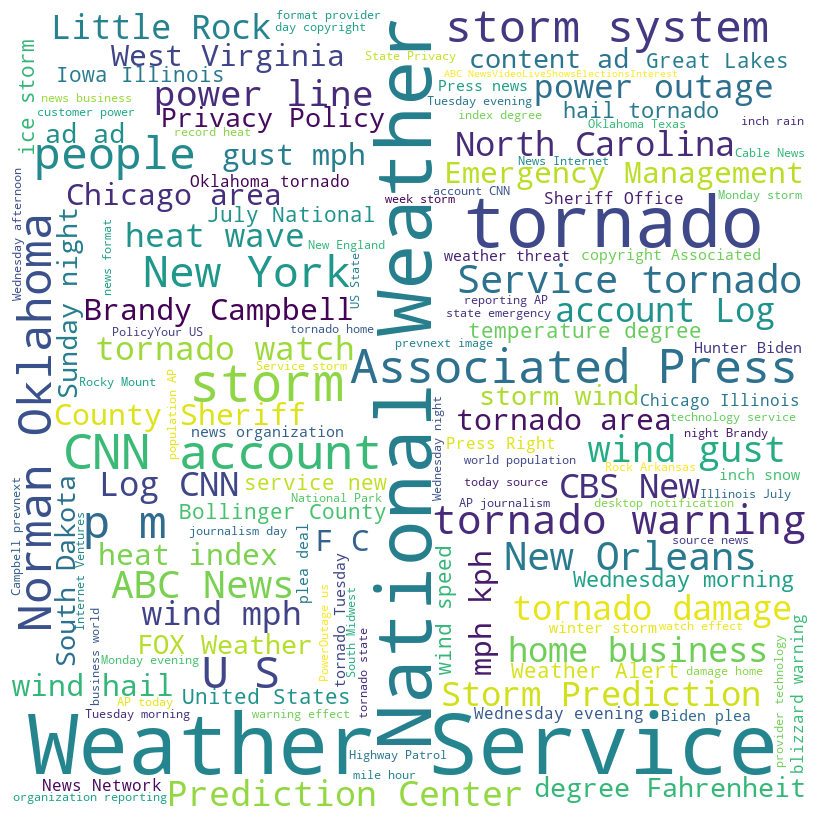

Cluster 1


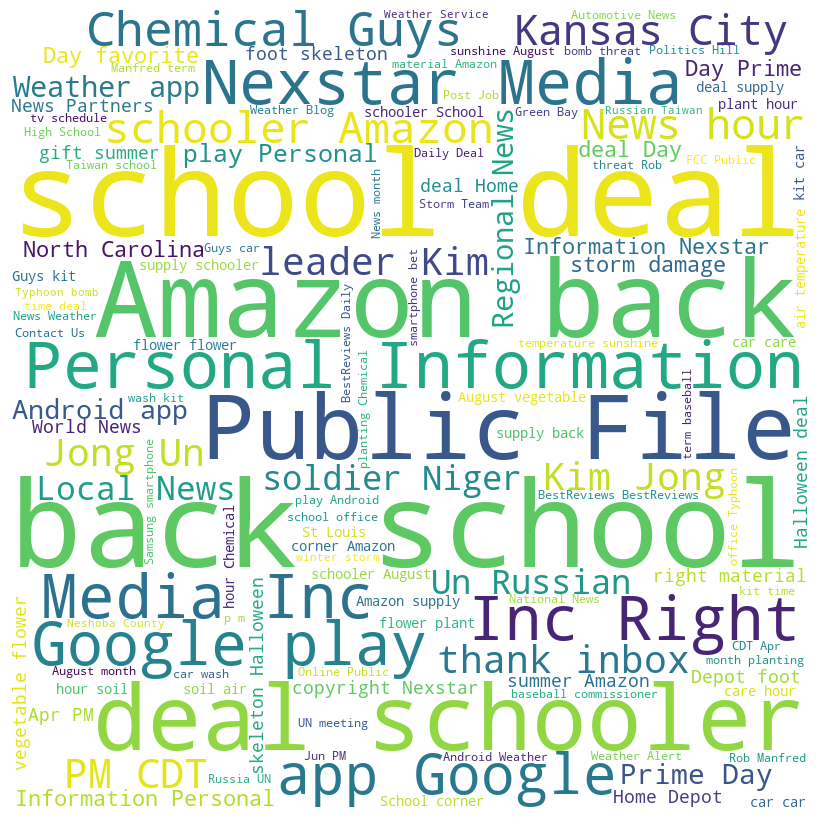

Cluster 2


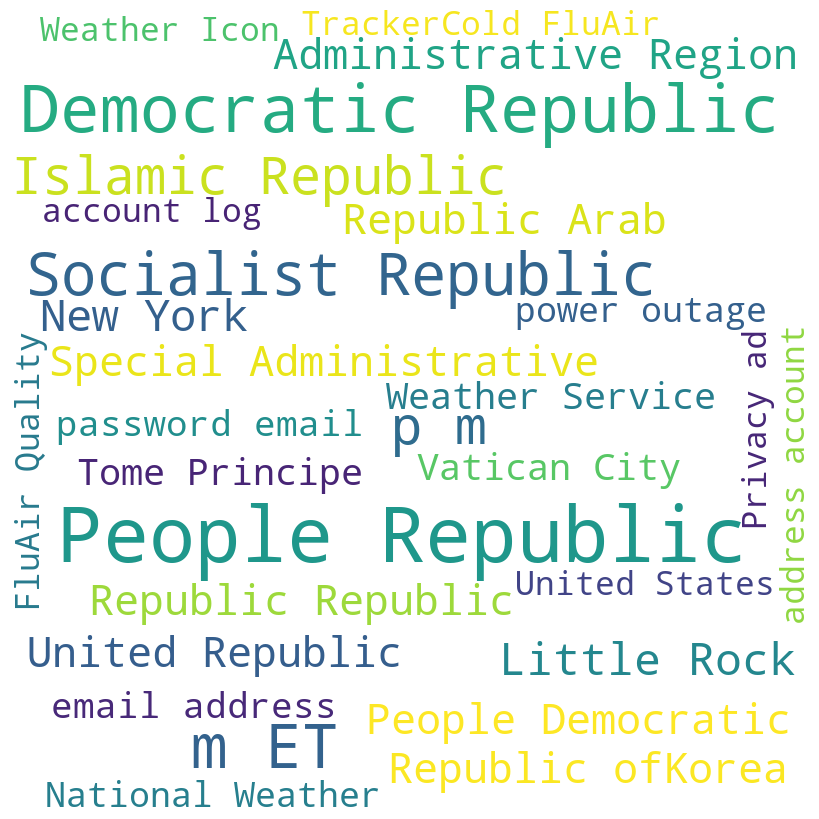

Cluster 3


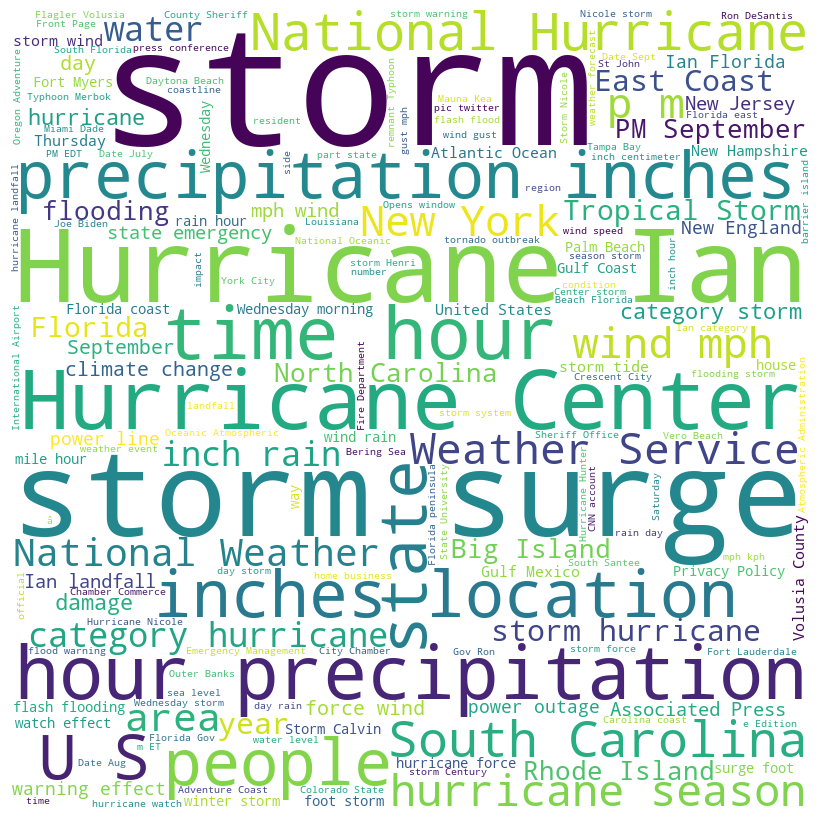

Cluster 4


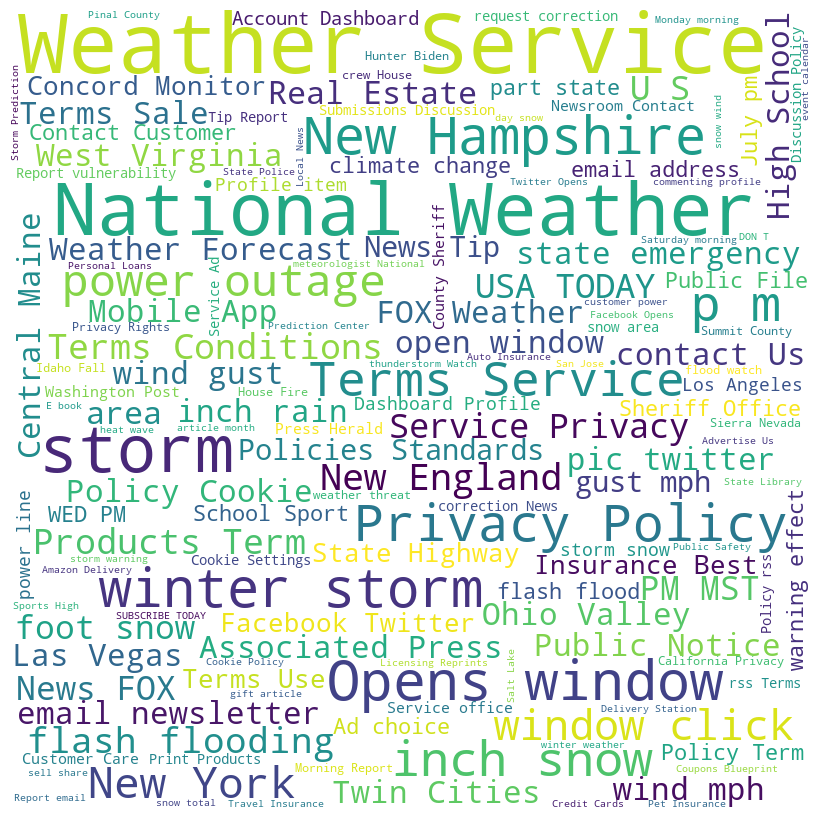

Cluster 5


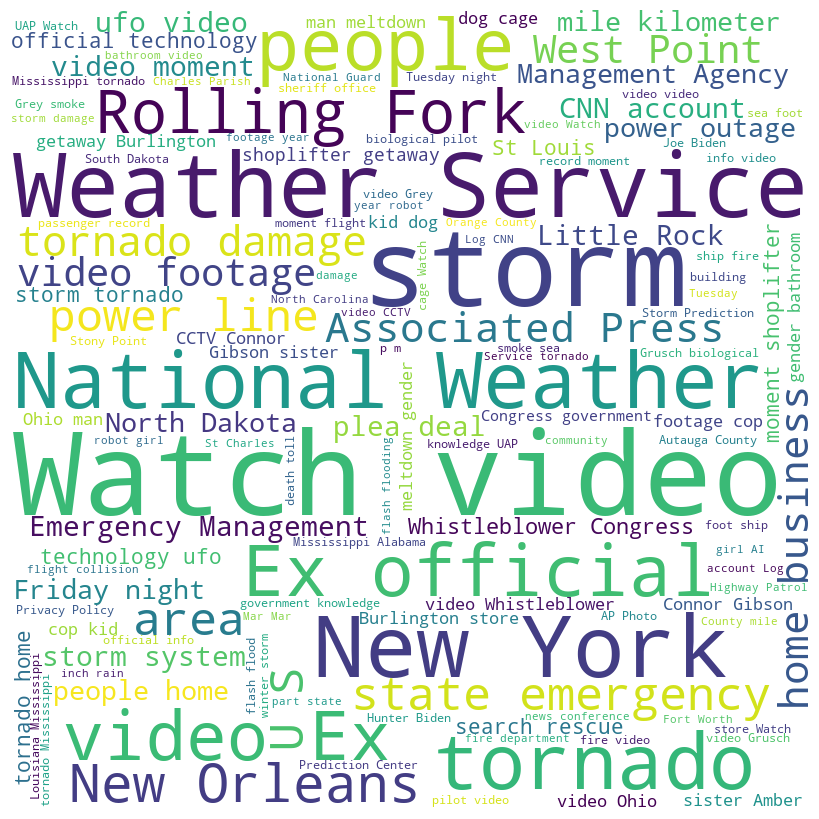

Cluster 6


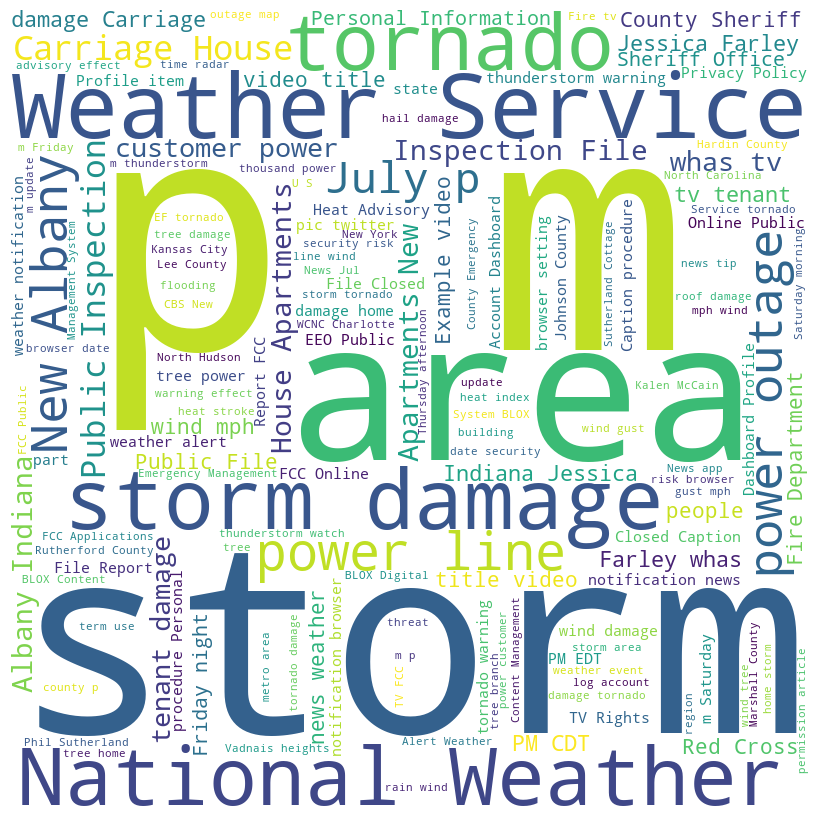

Cluster 7


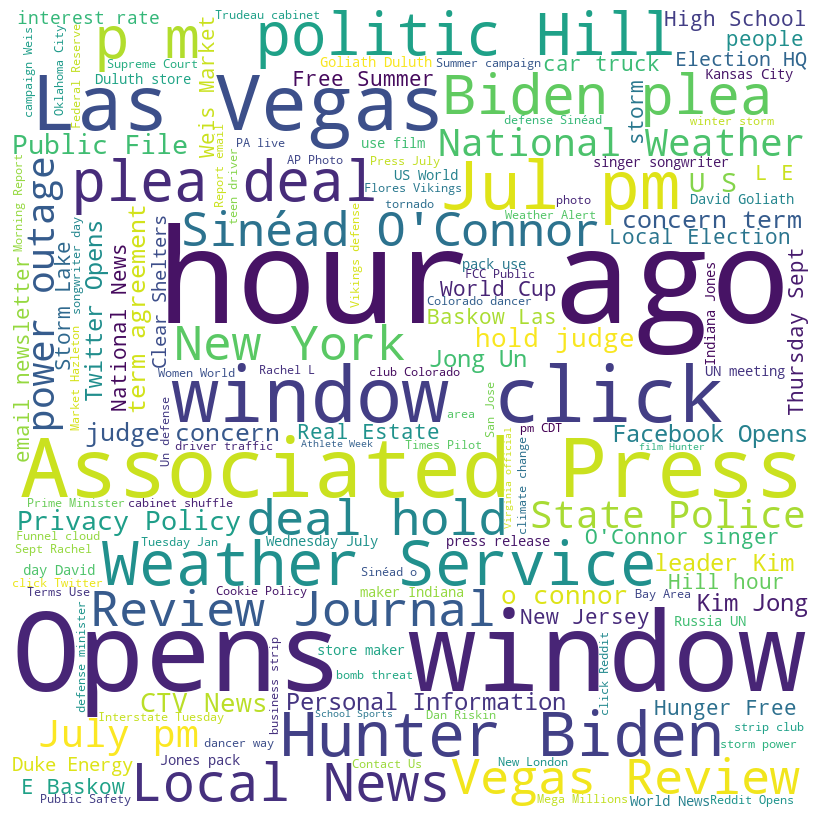

Cluster 8


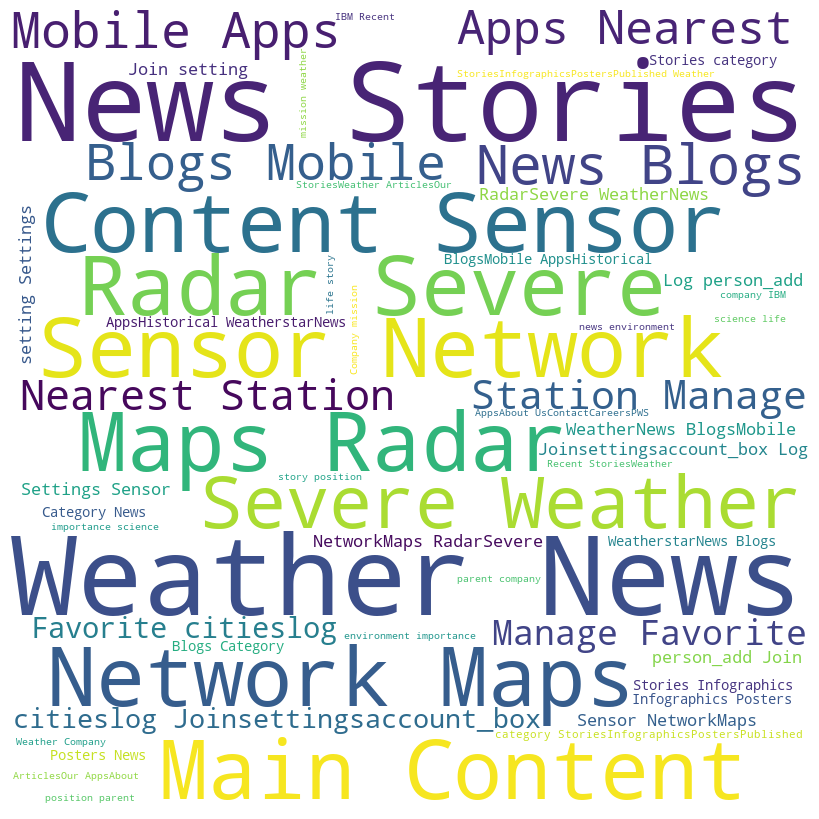

Cluster 9


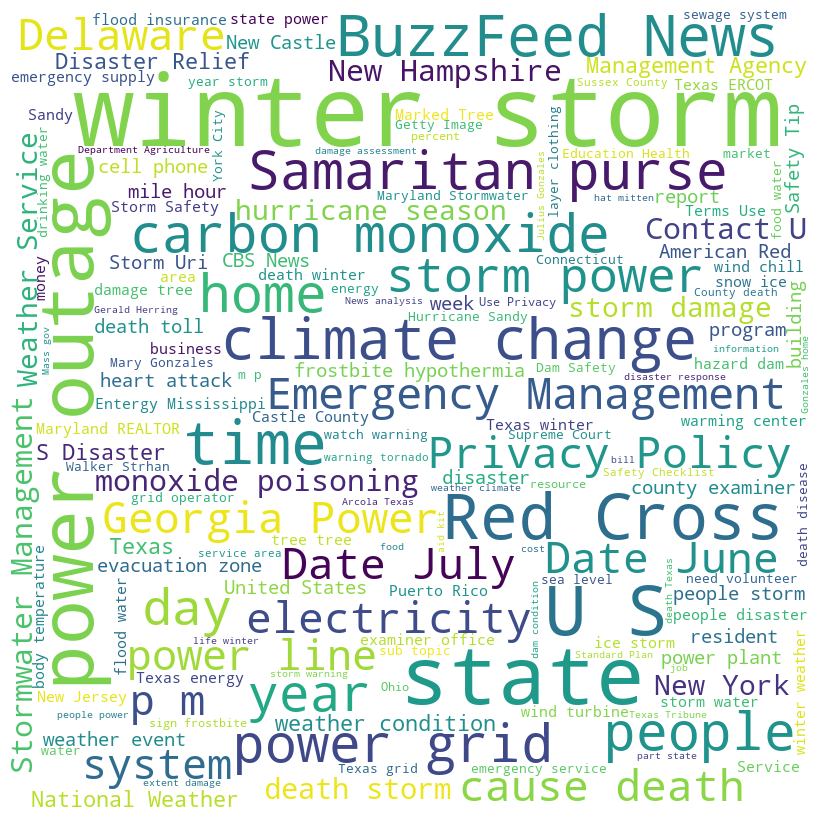

Cluster 10


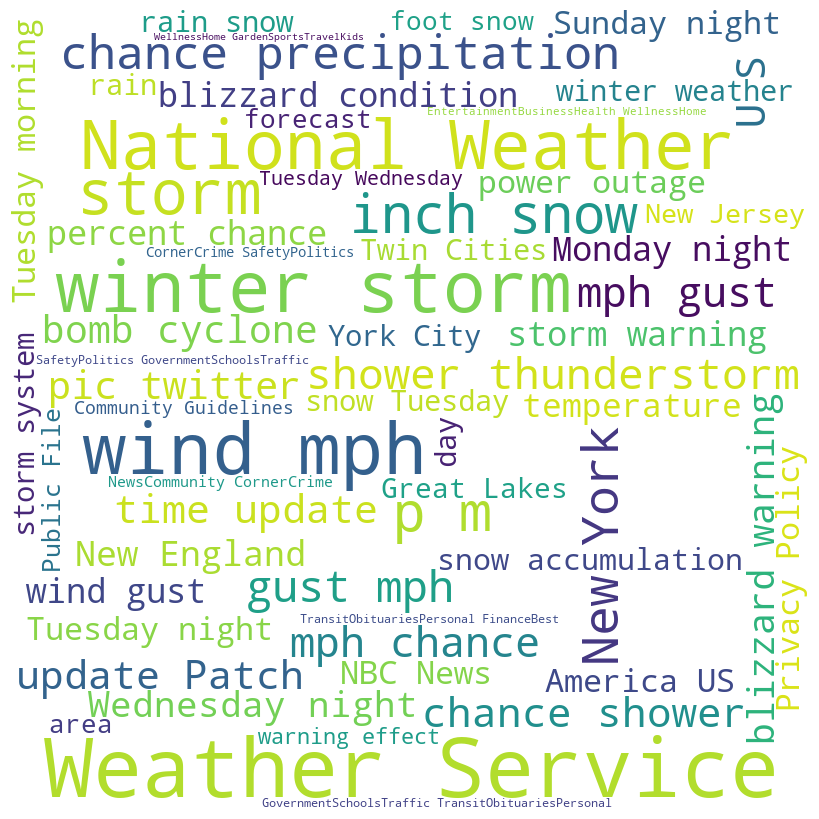

Cluster 11


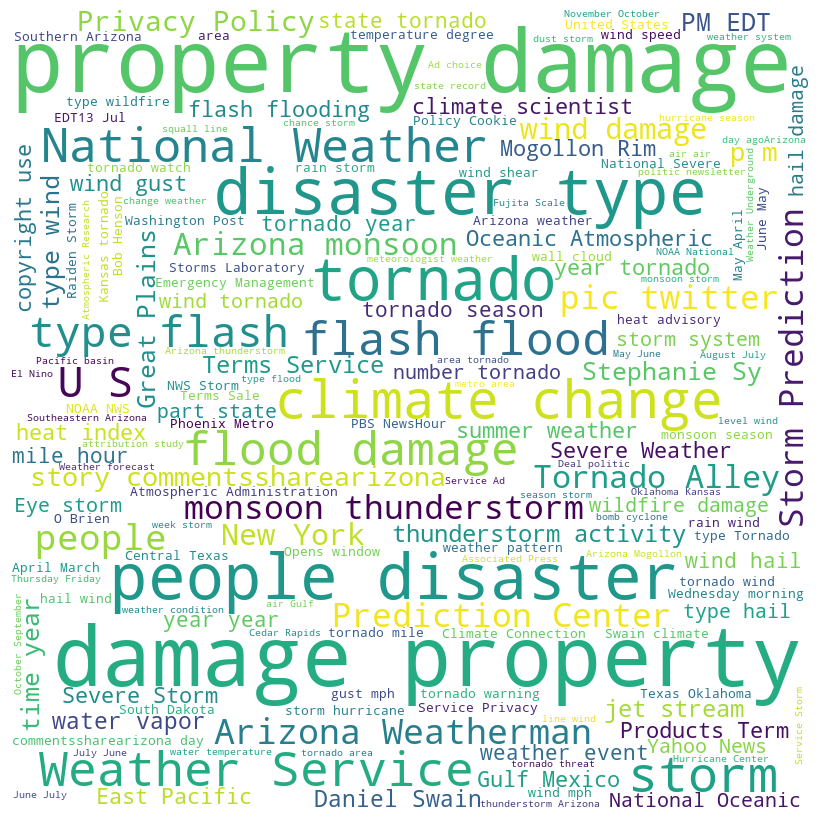

Cluster 12


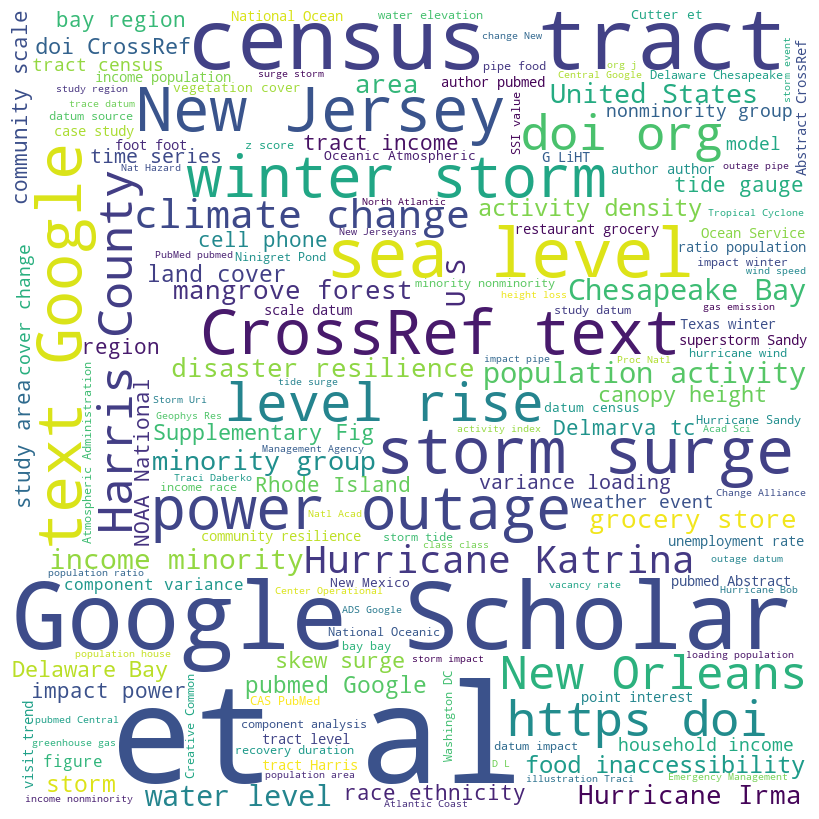

Cluster 13


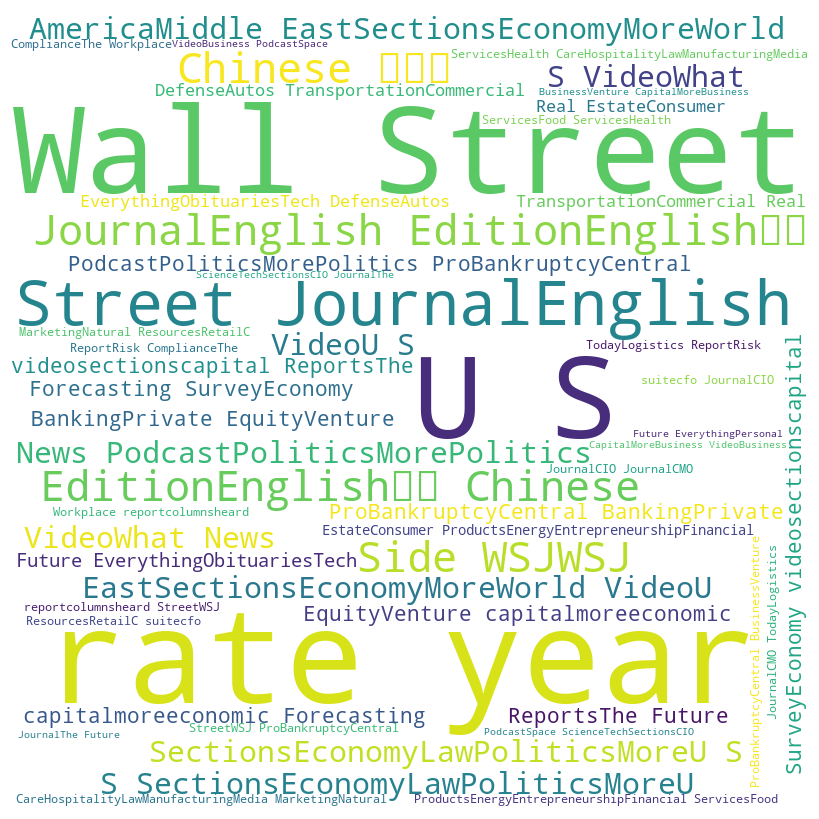

Cluster 14


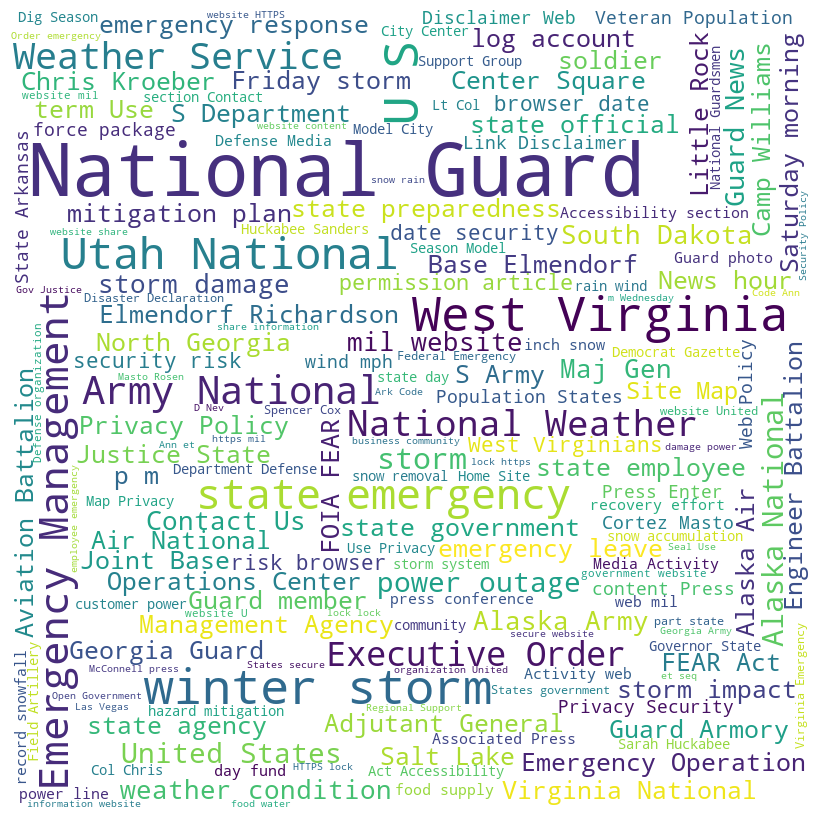

Cluster 15


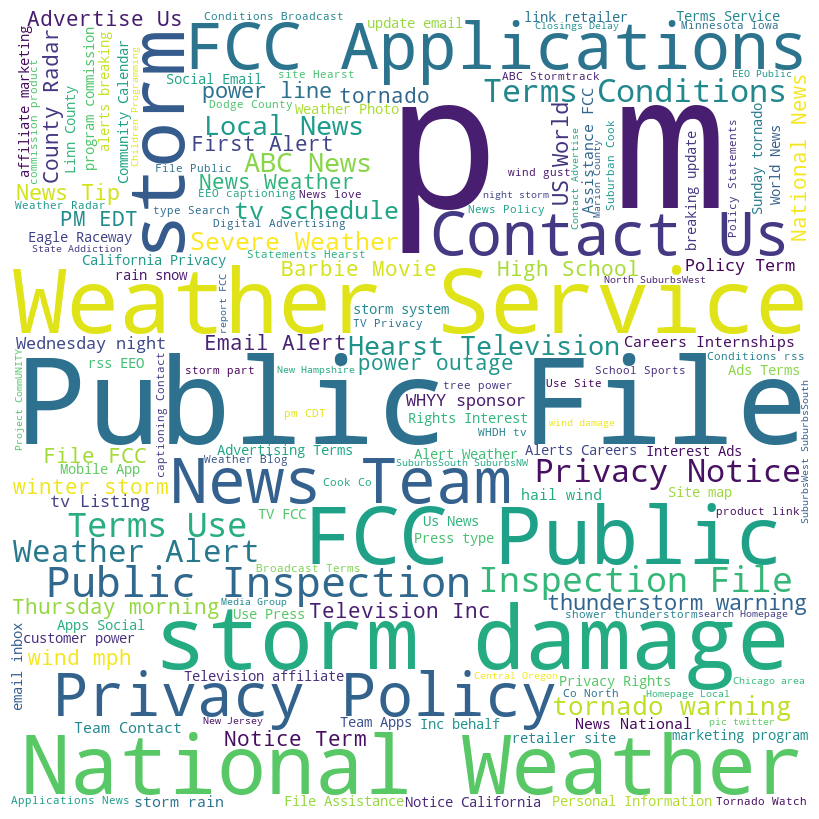

Cluster 16


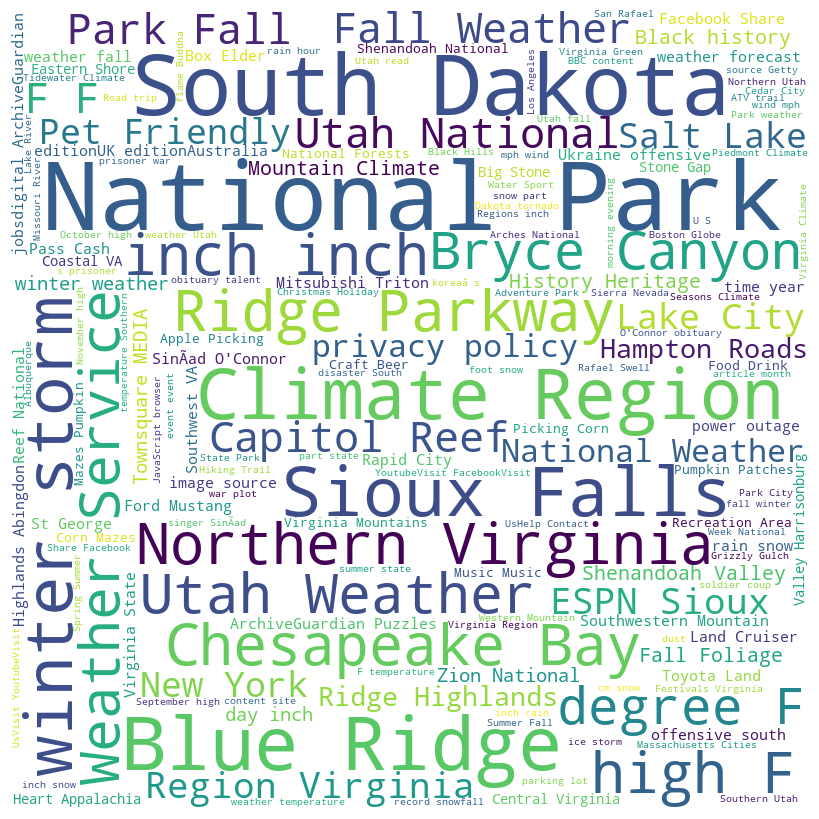

Cluster 17


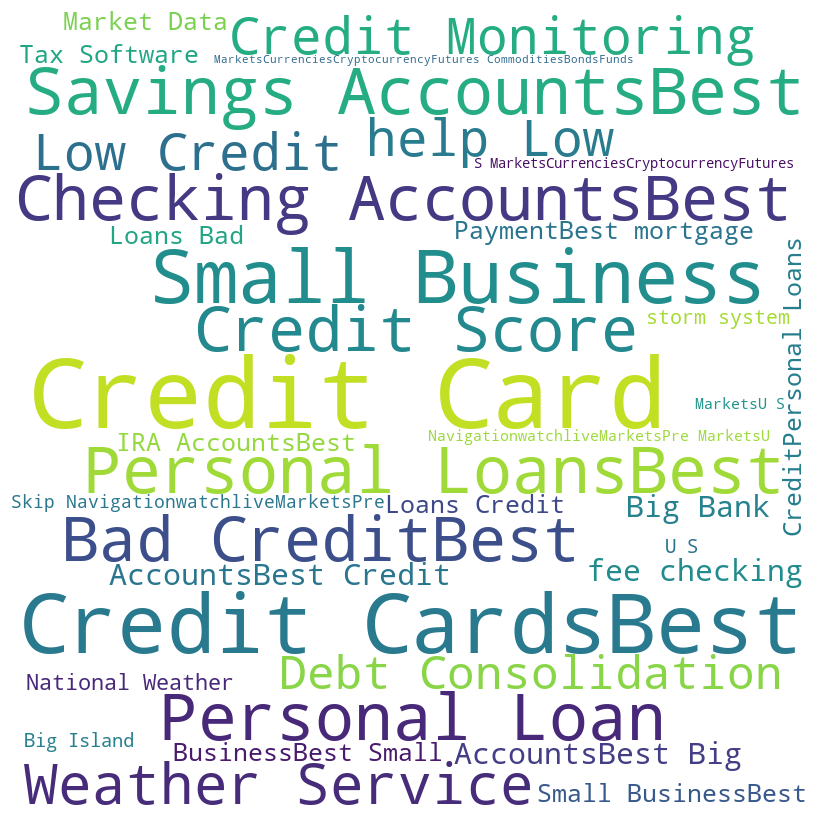

Cluster 18


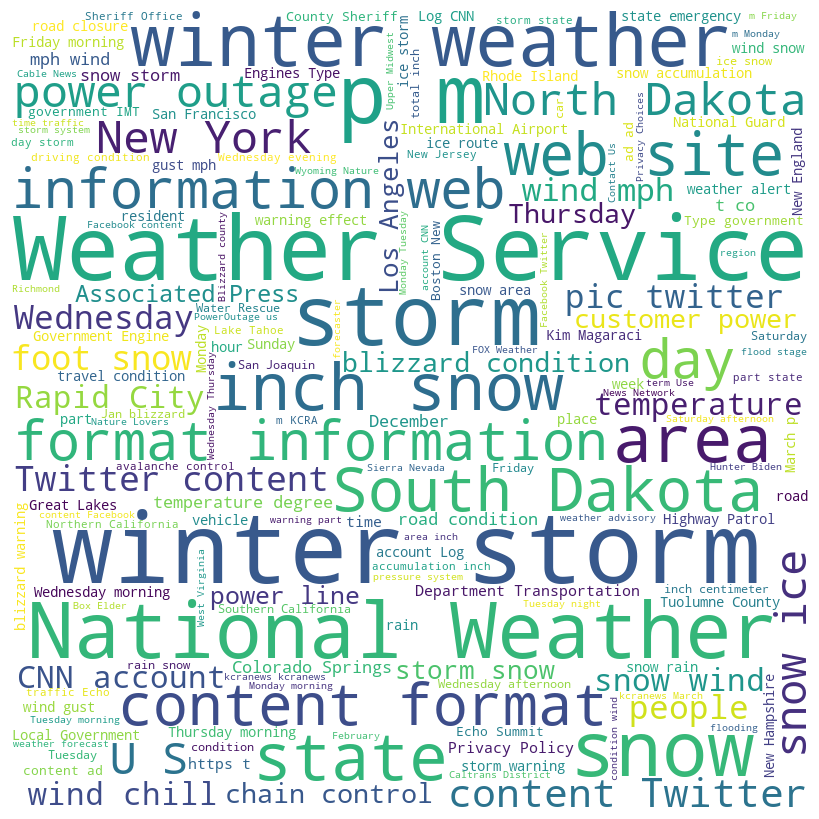

Cluster 19


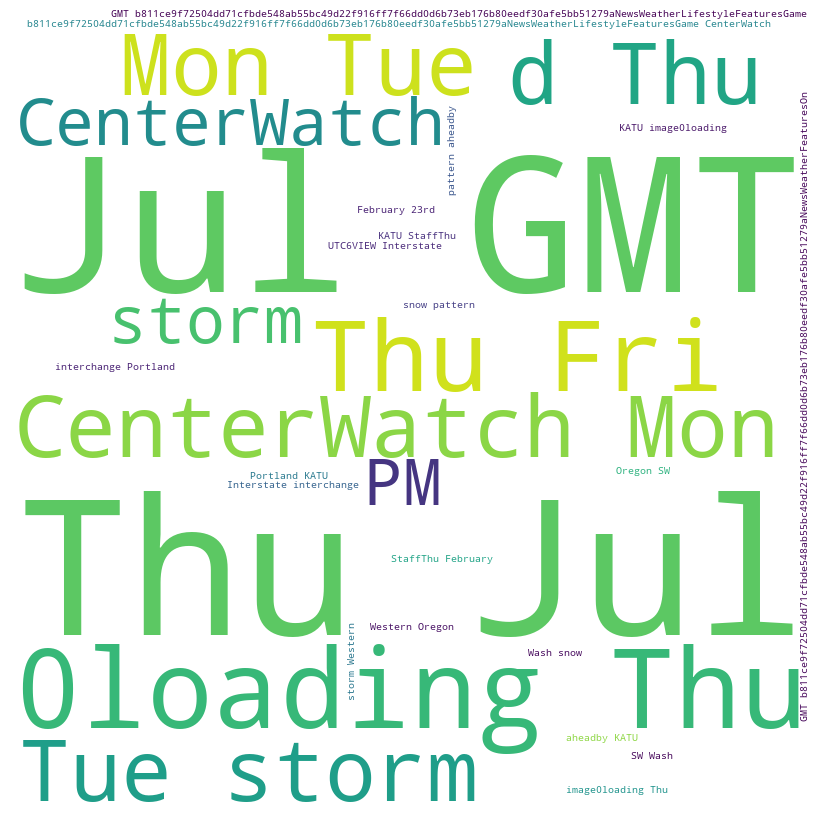

Cluster 20


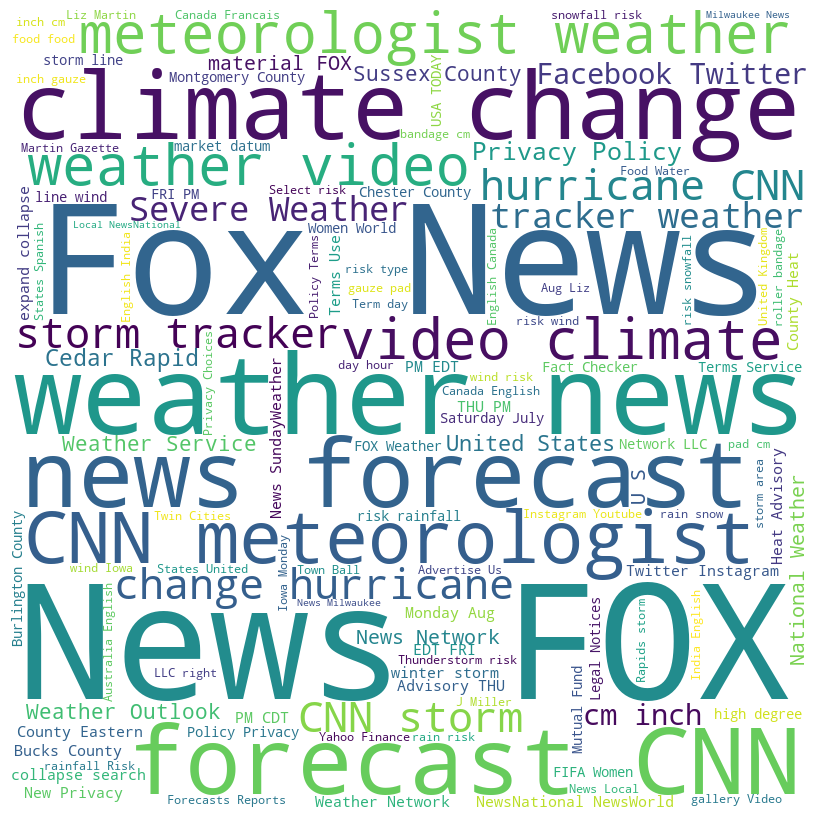

Cluster 21


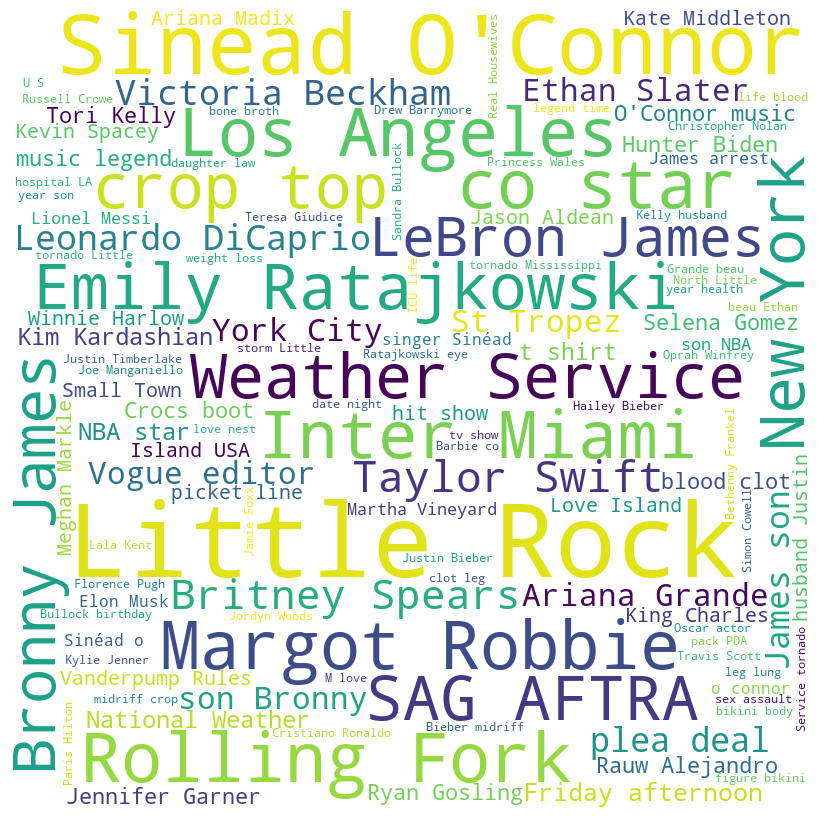

Cluster 22


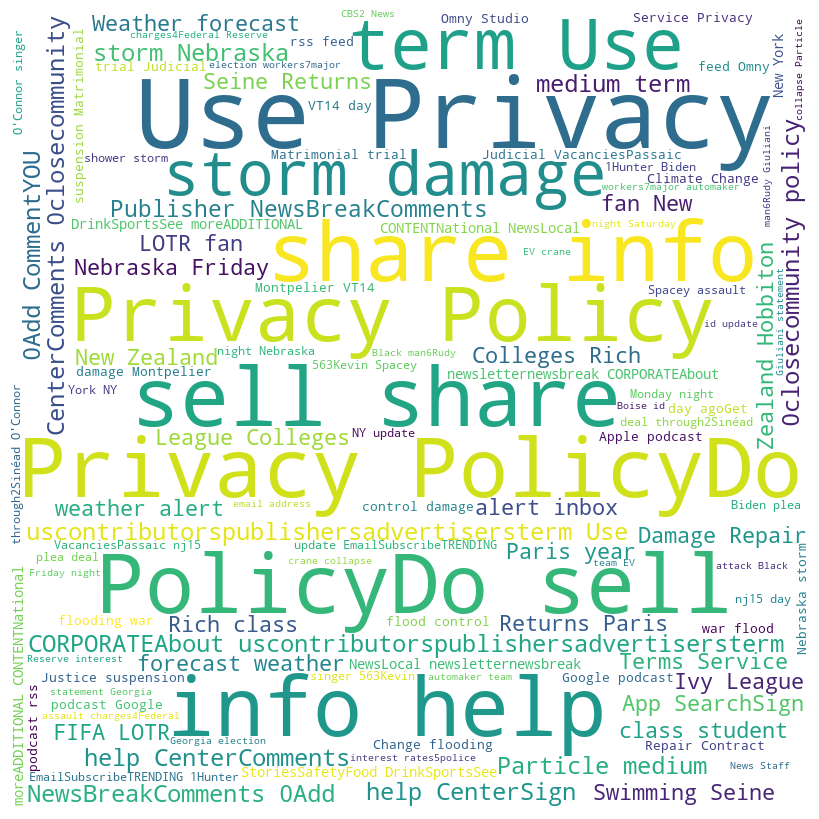

Cluster 23


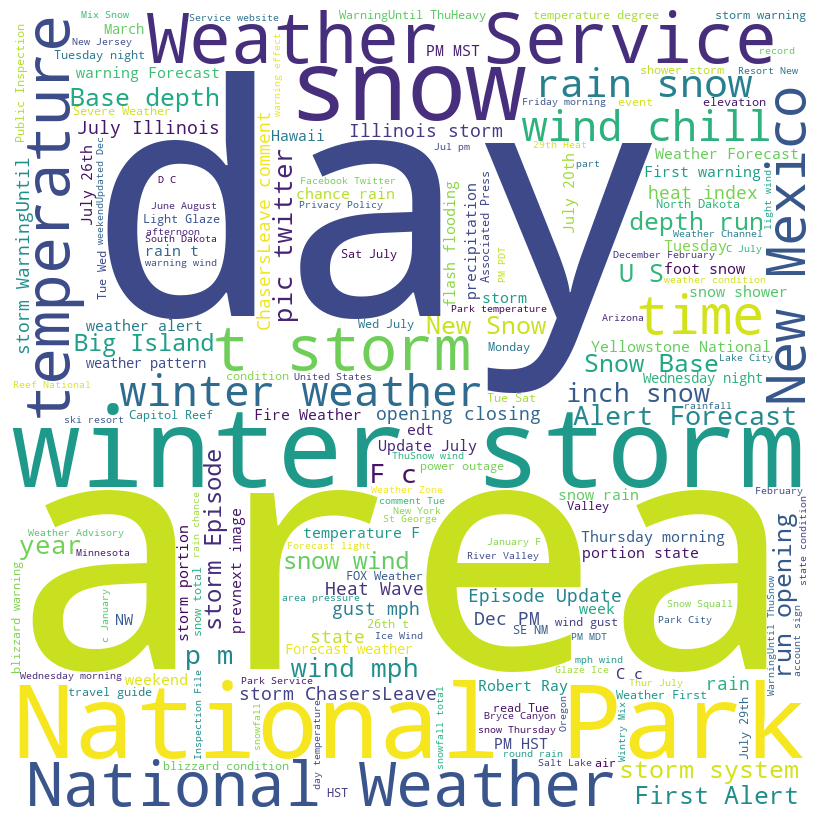

Cluster 24


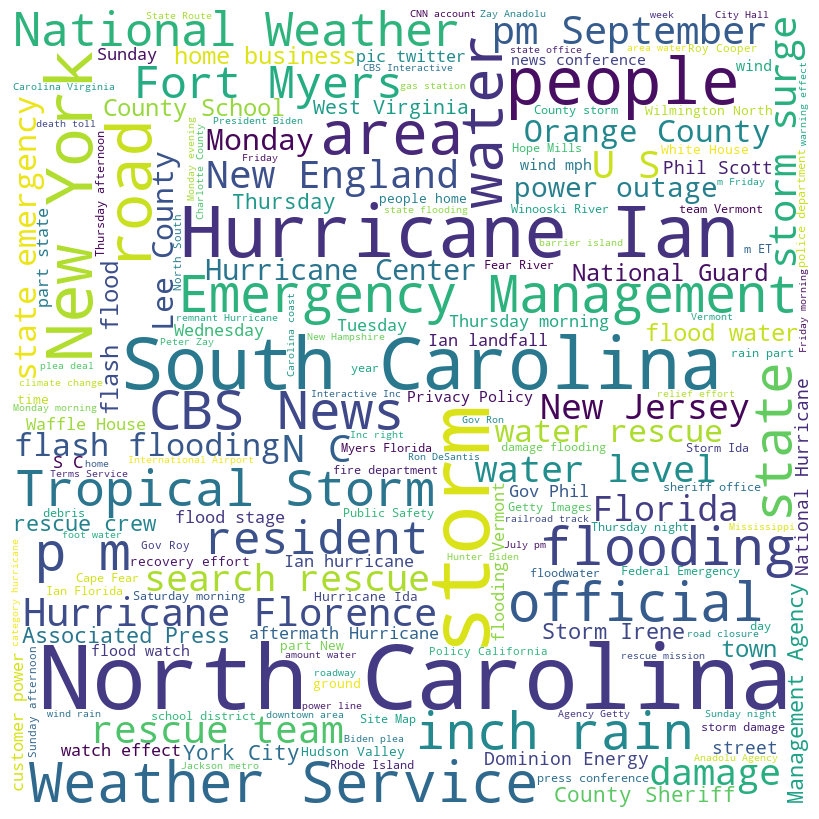

In [192]:
clusters_to_cloud(cluster_dict)

# Main call block for all functions to be ran based on selected criteria from user

In [215]:
def run_program(cluster_num):
    # Extract df from articles.pkl file and filter out unnecessary docs
    df = make_filter_df()
    print('make_filter done')

    # Clean text within column 'body_text' in dataframe df - takes approx. 2 to 3 mins
    df['body_text'] = [clean_text(text) for text in df['body_text']]
    print('cleaning done')

    # Save df as pickle after cleaning
    save_files(df, 'articles_cleaned')
    print('pickle 1 done')

    # Extract pickle to skip above for testing
    # df = pd.read_pickle('articles_cleaned.pkl')

    # Perform tokenization and tagging - averages 18 min run
    pos_tagging(df)
    print('tagging done')

    # Filtering again
    # Remove from df rows with empty cells in the POS tag columns - reassignment temporary due to slicing issues
    a = df.loc[~df['nouns'].isnull()]
    df = a
    # Reset index
    df = df.reset_index(drop=True)
    print('filter 2 done')

    # Store files during checkpoint
    save_files(df, 'articles_extended')
    print('pickle 2 done')

    # Extract pickle again to skip above for testing
    # df = pd.read_pickle('articles_cleaned.pkl')

    # Document term matrix TFIDF
    tfidf_v, tfidf_vectors = tfidf_vectorize(df)
    print('tfidf done')

    # w2v embedder
    word_vectors = w2v_embedder(df, 'articles_extended')
    print('w2v done')

    # Document embedder
    doc_vectors = doc_embedder(tfidf_v, tfidf_vectors, word_vectors)
    print('doc_v done')

    # Clustering
    kmeans_clusters, clusters_dict = k_clusters(df, cluster_num, doc_vectors, True)
    print('kmeans done')

    # Store df with clusters as pickle if needed for temporary analysis
    current = datetime.now().strftime("%Y-%m-%d %H-%M-%S")
    df.to_pickle(f'./clusters_pickles/k_cluster_{cluster_num}_{str(current)}.pkl')
    print('pickle 3 done')

    # Calculate mean similarity
    clusters_dict = mean_similarity(kmeans_clusters, clusters_dict, cluster_num, doc_vectors)
    print('mean similarity done')

    # Perform wordcloud for each cluster
    clusters_to_cloud(clusters_dict)
    print('wordcloud done')

    return df, clusters_dict, doc_vectors, tfidf_vectors, word_vectors

# RUN MAIN CALL FUNCTION

In [197]:
import warnings
warnings.filterwarnings('ignore')

make_filter done
cleaning done
pickle 1 done


Defaulting to user installation because normal site-packages is not writeable


You should consider upgrading via the '/Library/Developer/CommandLineTools/usr/bin/python3 -m pip install --upgrade pip' command.


✔ Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')
tagging done
filter 2 done
pickle 2 done
tfidf done
w2v done


100%|██████████| 4317/4317 [00:50<00:00, 85.02it/s] 


doc_v done

Cluster 0 contains a total of 200 documents with the following titles:

                                                             title
Document Number                                                   
6                Extreme wind, snow left thousands without powe...
7                Storm Area 51 still affects tiny Nevada town a...
63               Montana and North Dakota are hit by 'one-in-a-...
78               North Dakota remembers a 'perfect' storm - Agw...
80               Winter Storm Preparedness & Blizzard Safety | ...
...                                                            ...
4213             Storm strands hundreds overnight on Virginia h...
4242             Portland, Oregon Highway Becomes Parking Lot D...
4285             Winter Storm Preparedness & Blizzard Safety | ...
4302             nycsubway.org: The Blizzard of 1888; the Impac...
4306             Wind, hail and winter storm were among costly ...

[200 rows x 1 columns]

Cluster 1 contains a

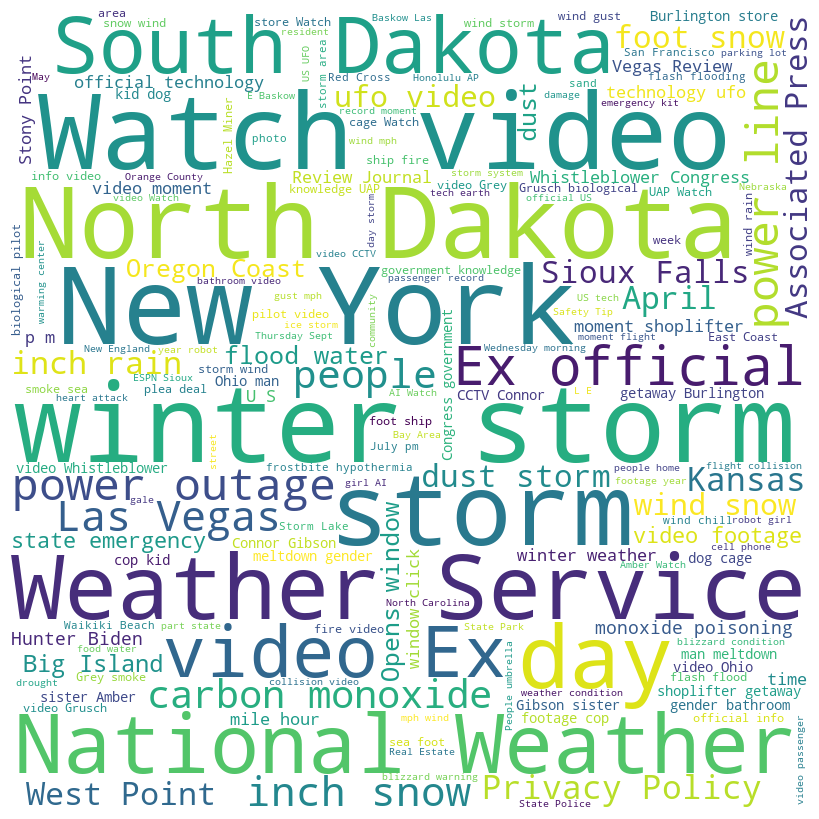

Cluster 1


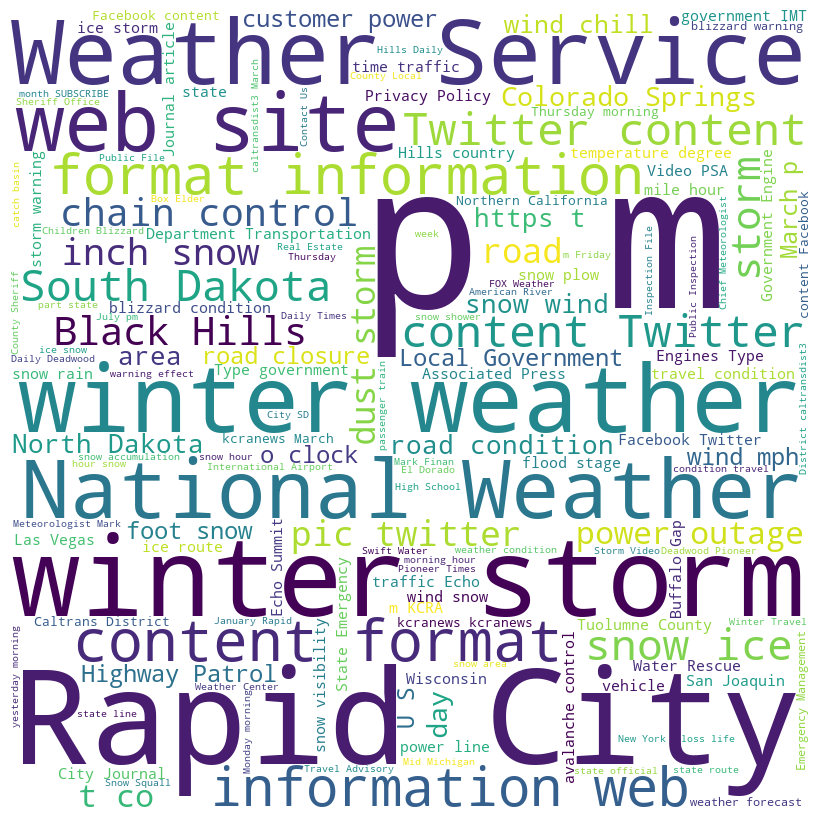

Cluster 2


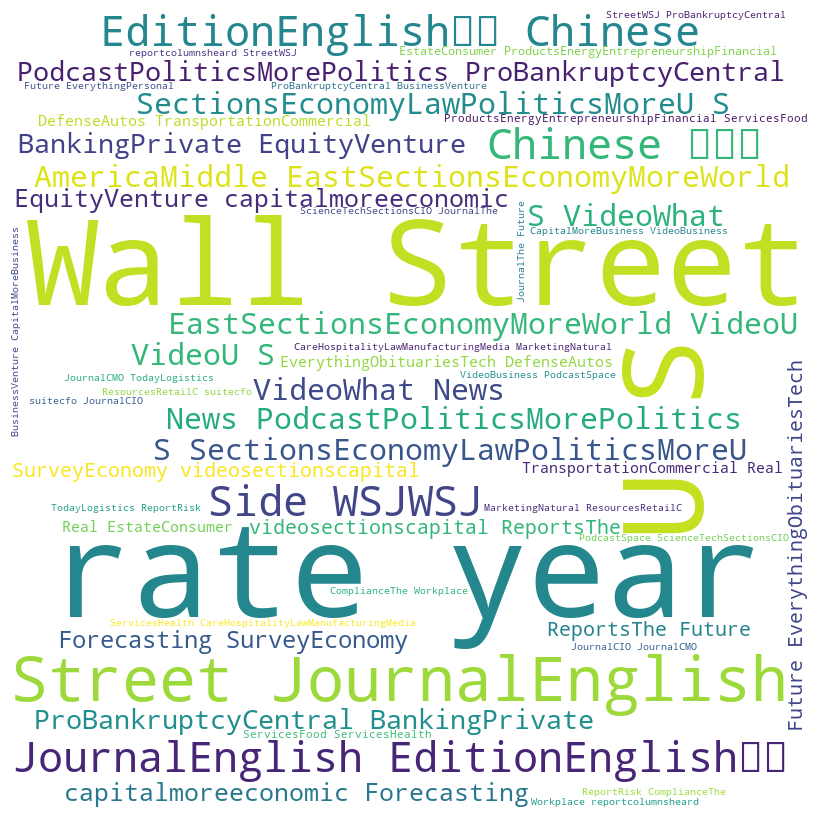

Cluster 3


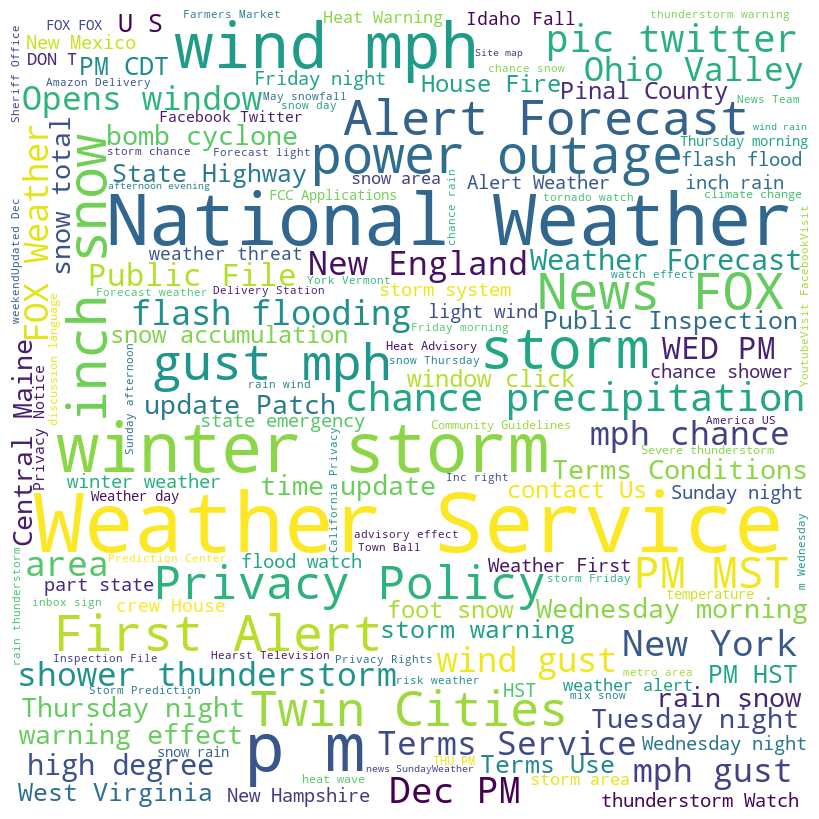

Cluster 4


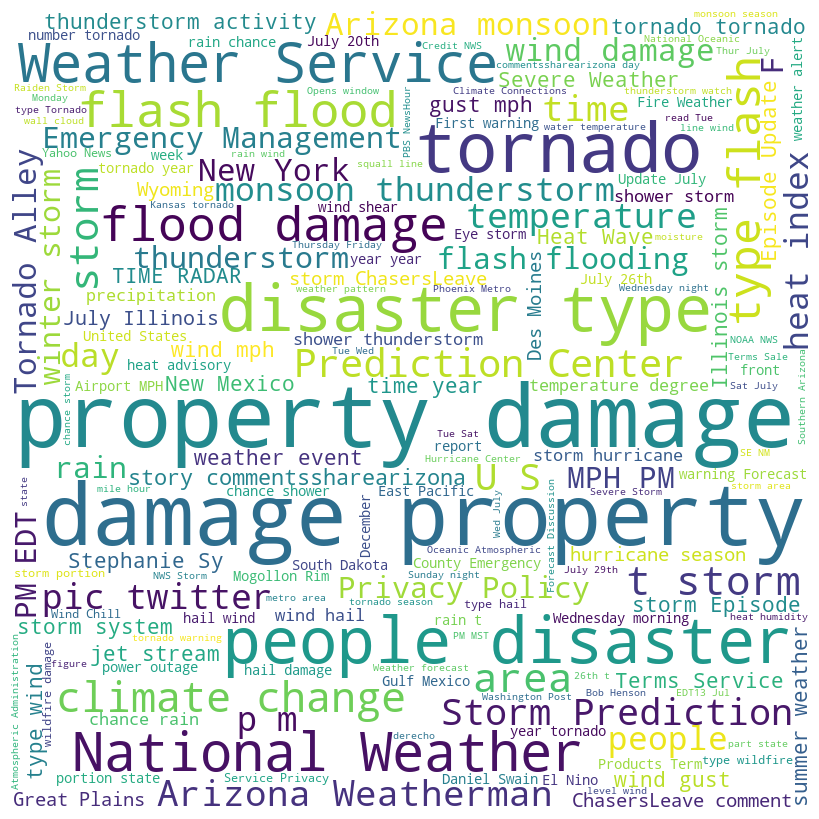

Cluster 5


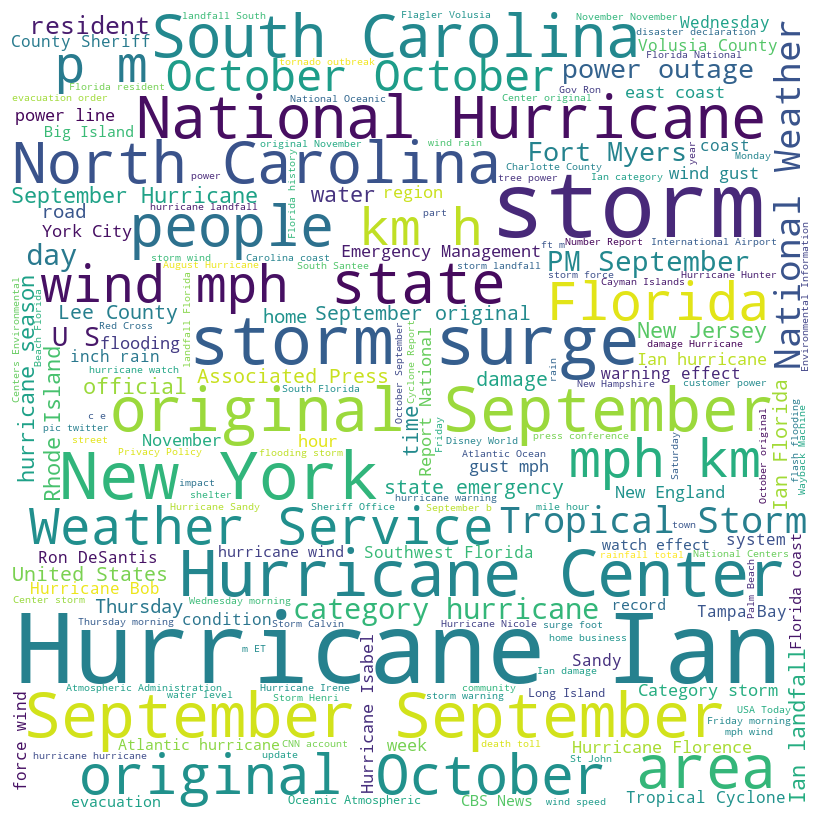

Cluster 6


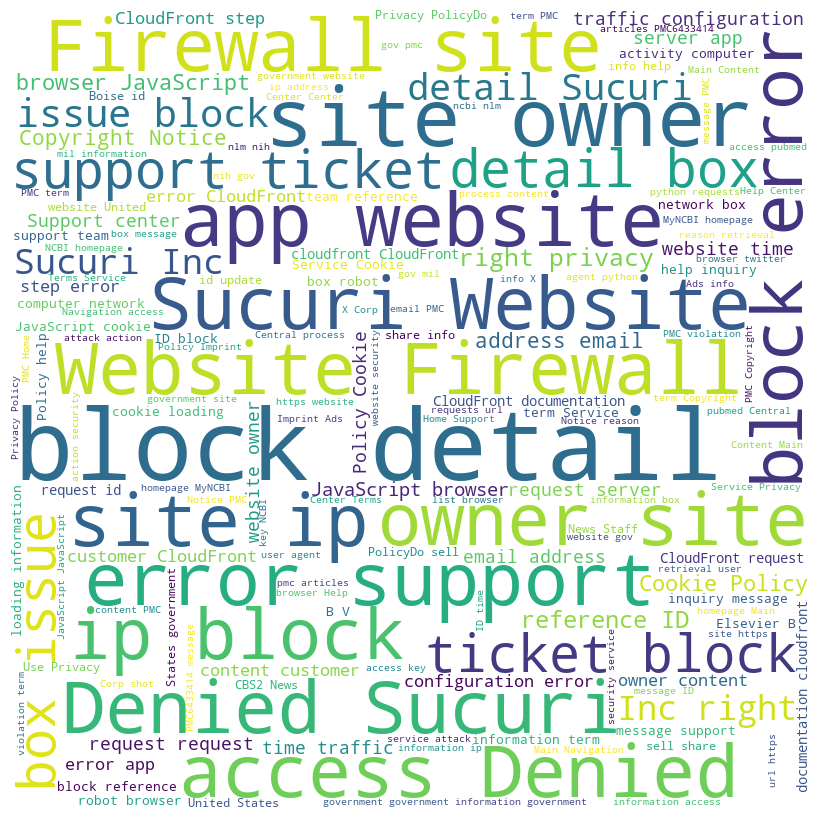

Cluster 7


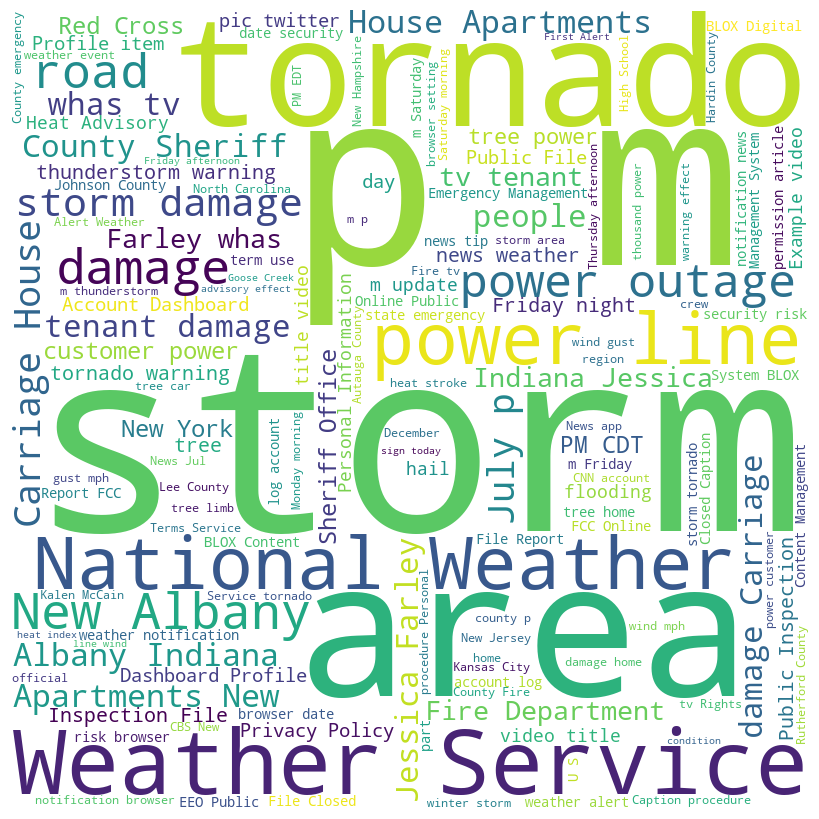

Cluster 8


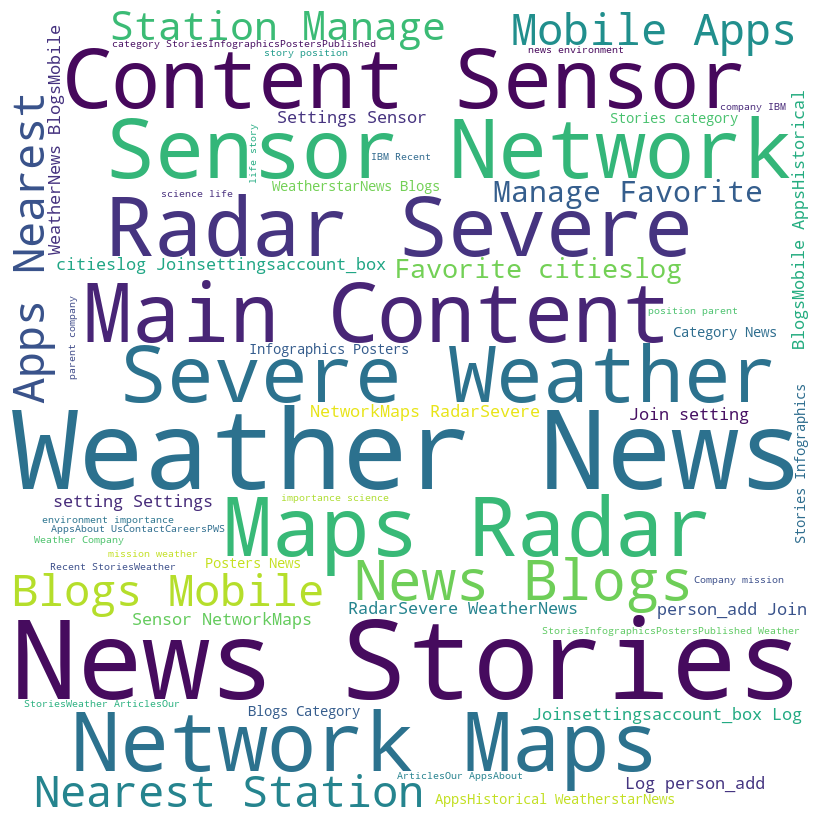

Cluster 9


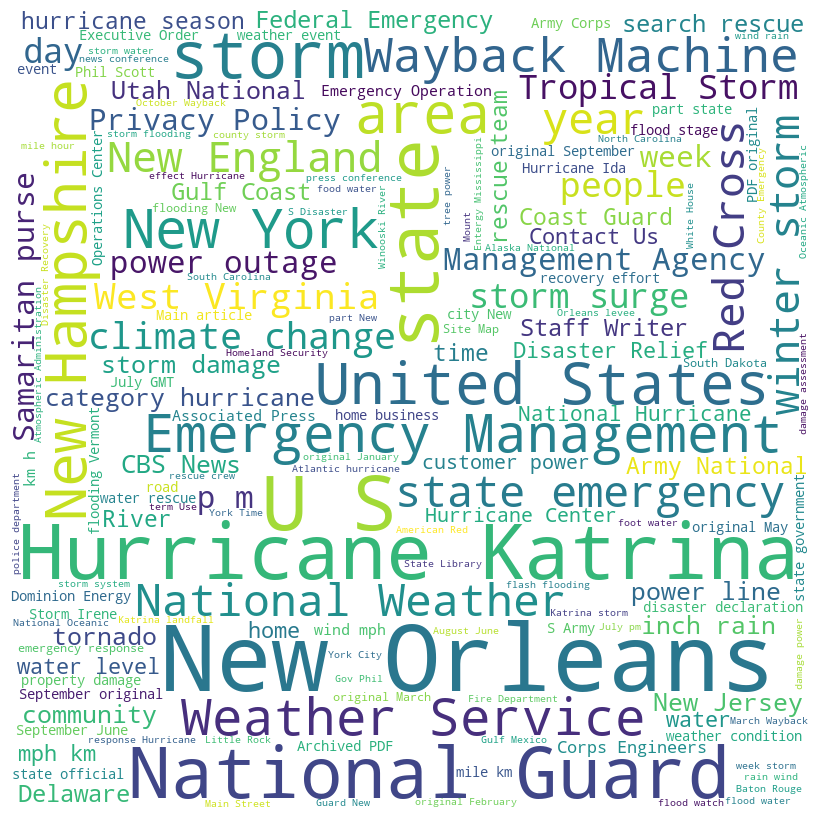

Cluster 10


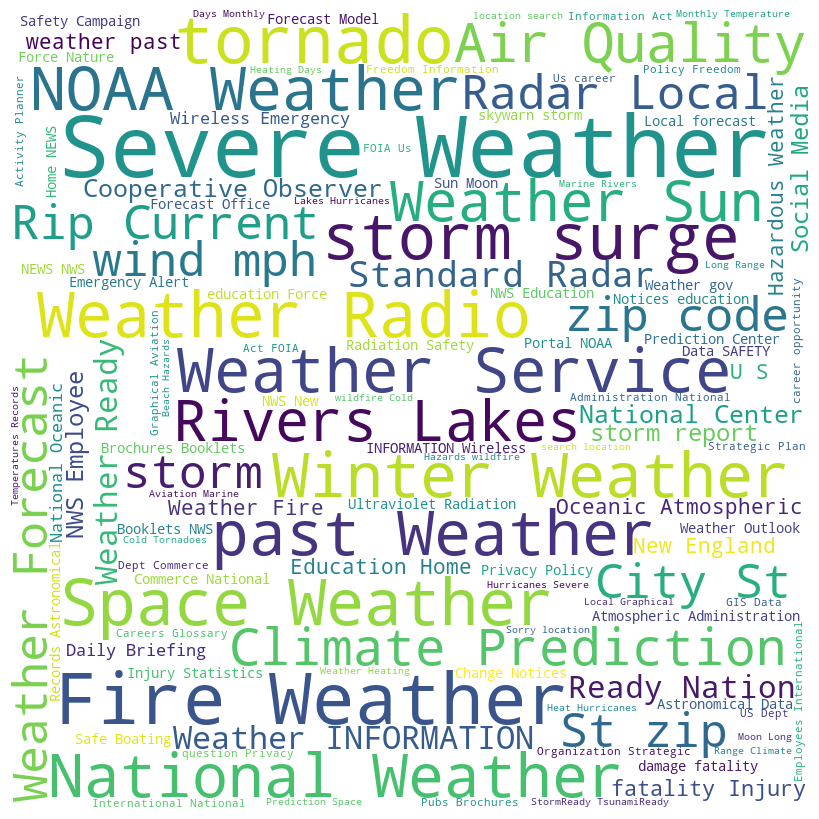

Cluster 11


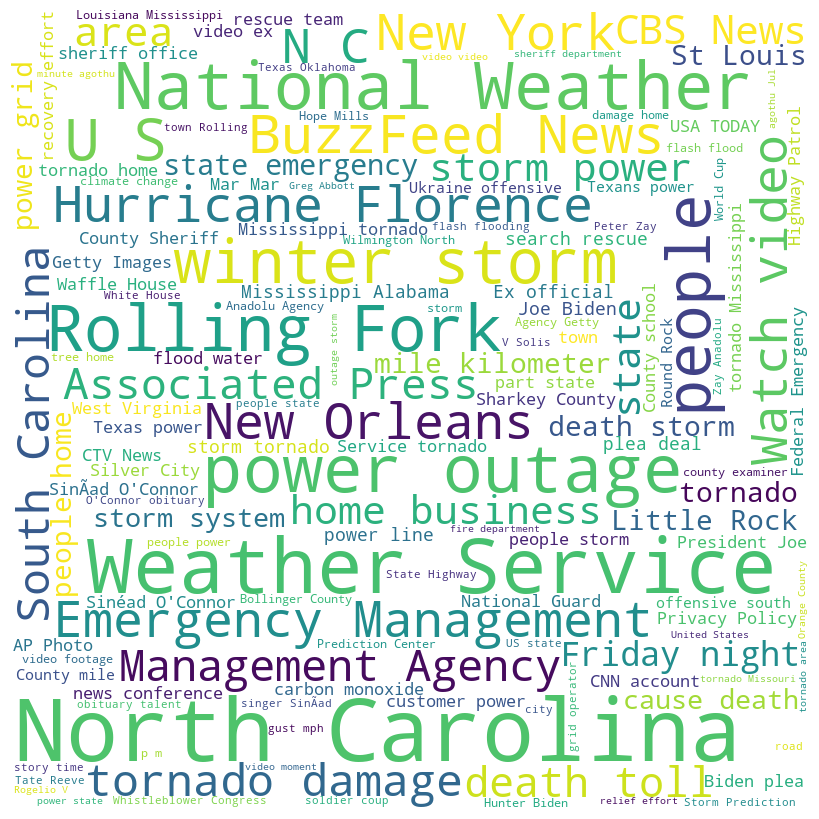

Cluster 12


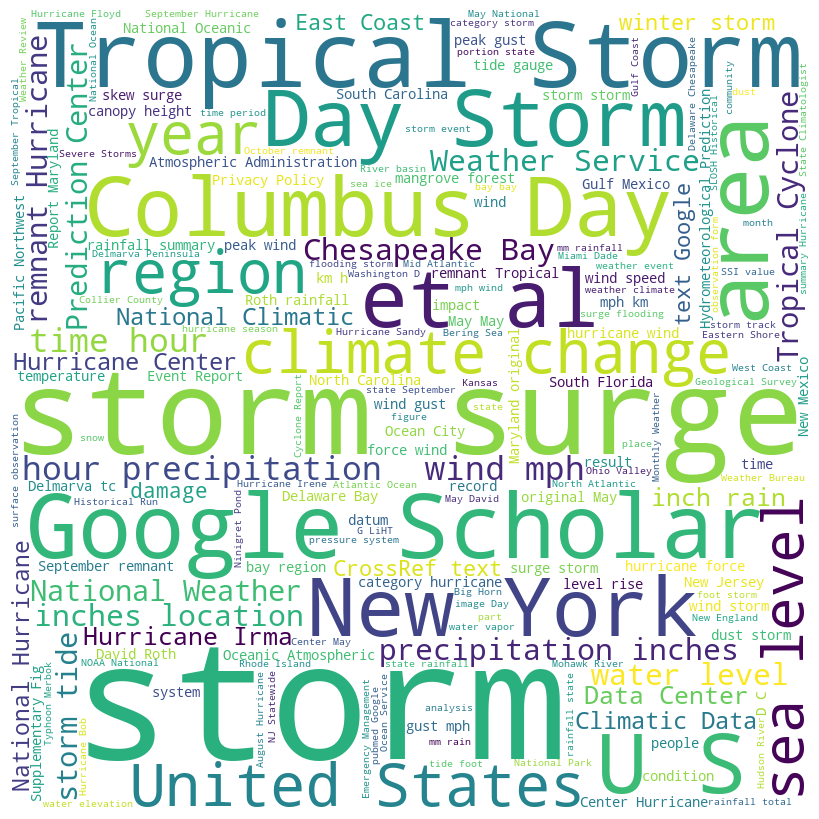

Cluster 13


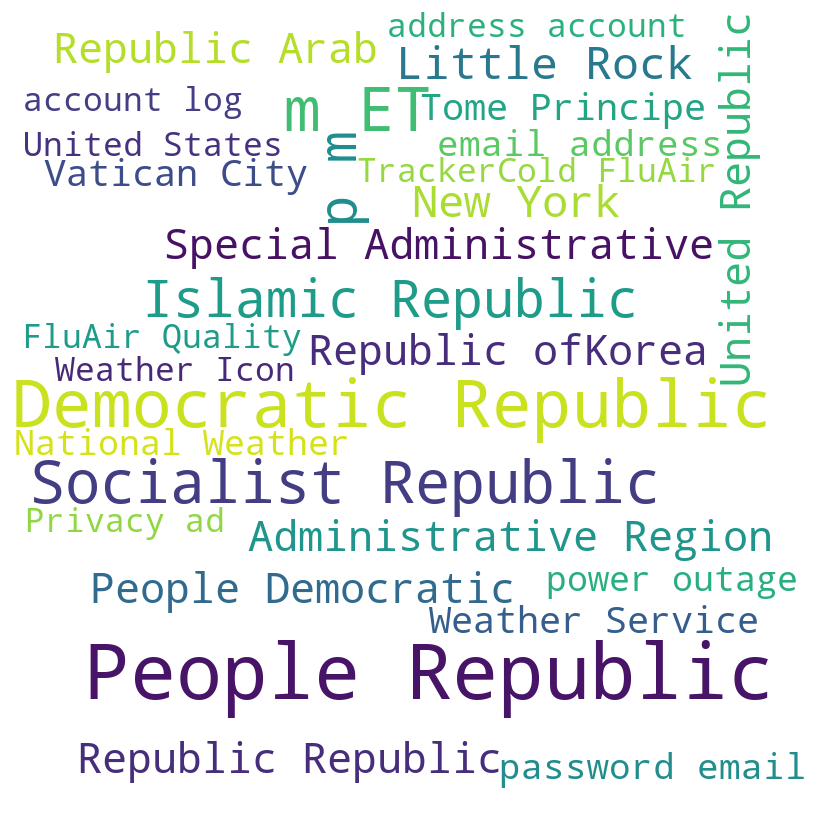

Cluster 14


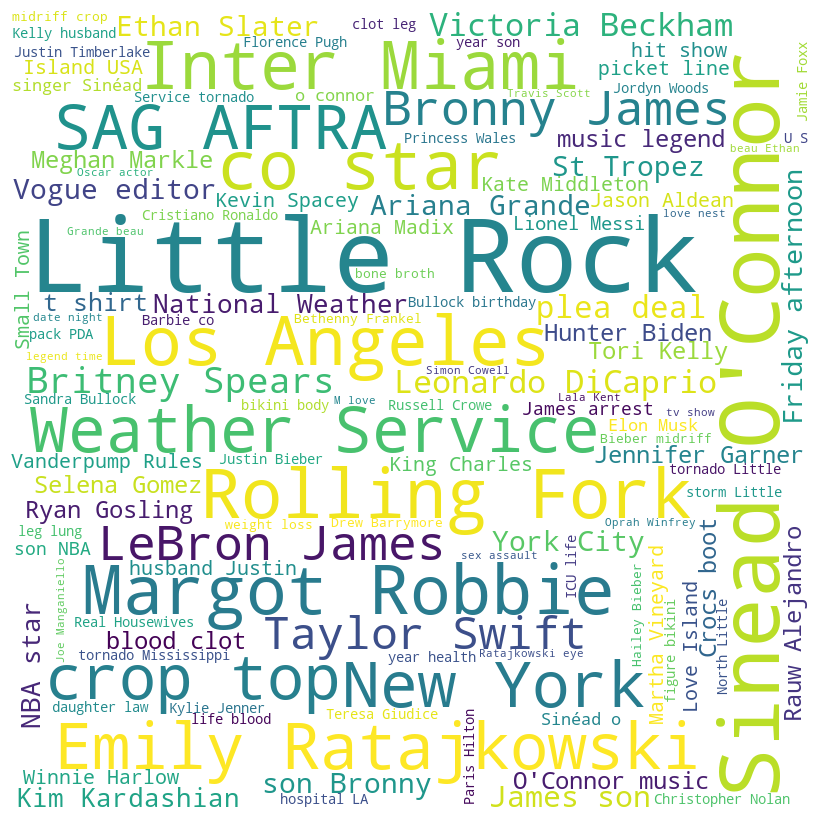

Cluster 15


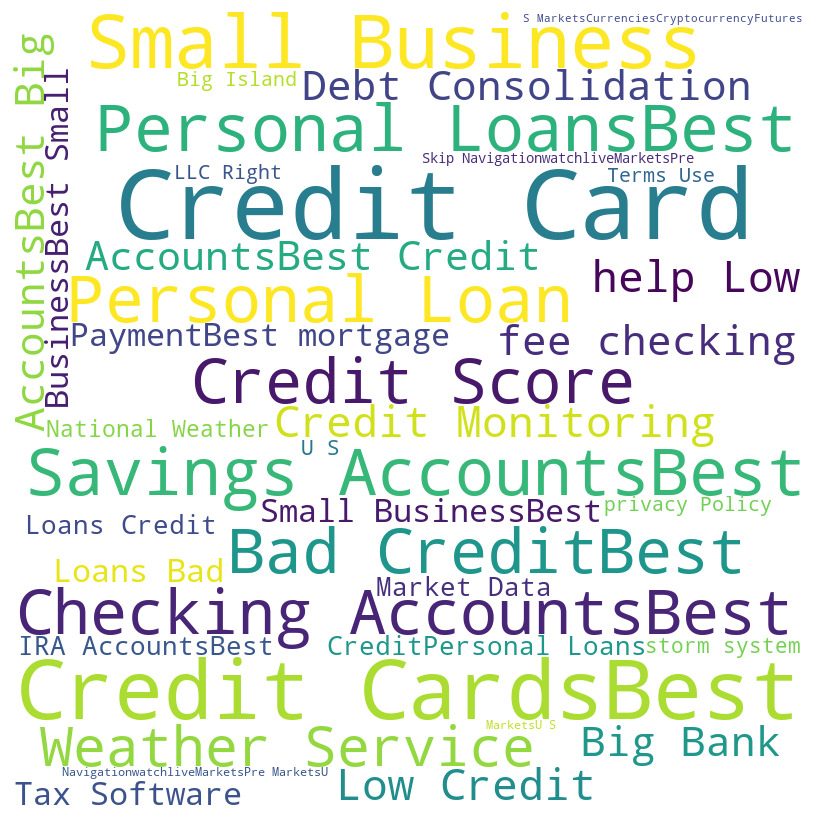

Cluster 16


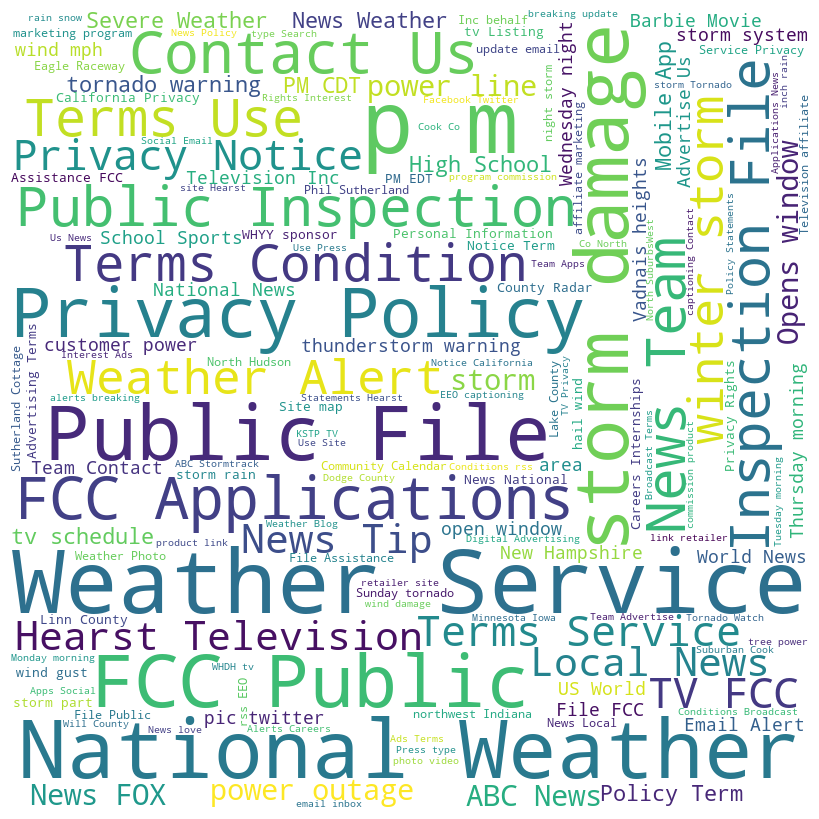

Cluster 17


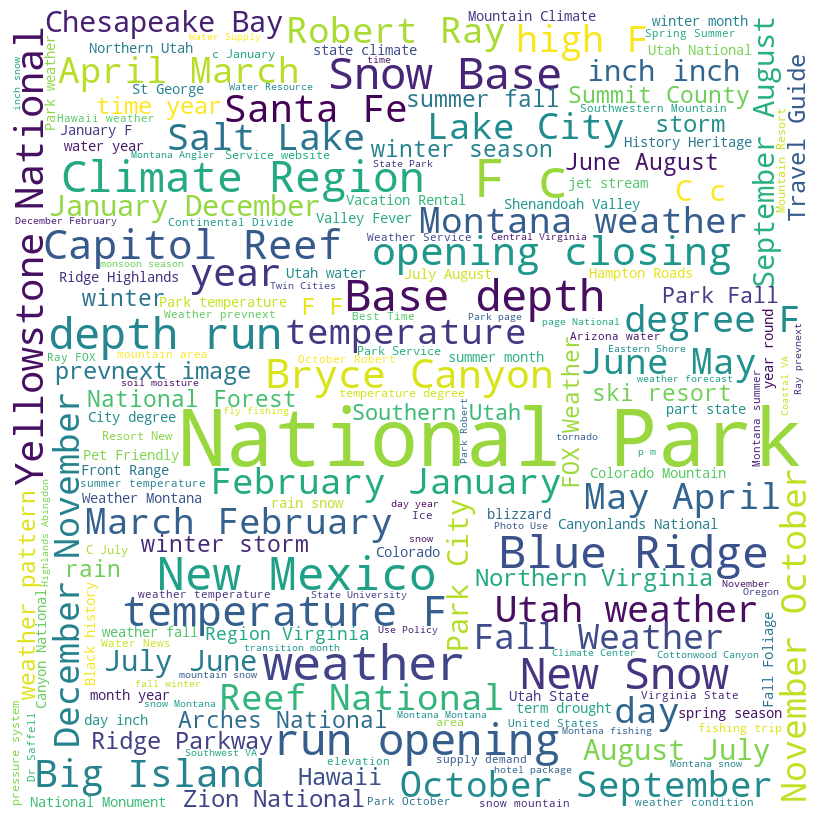

Cluster 18


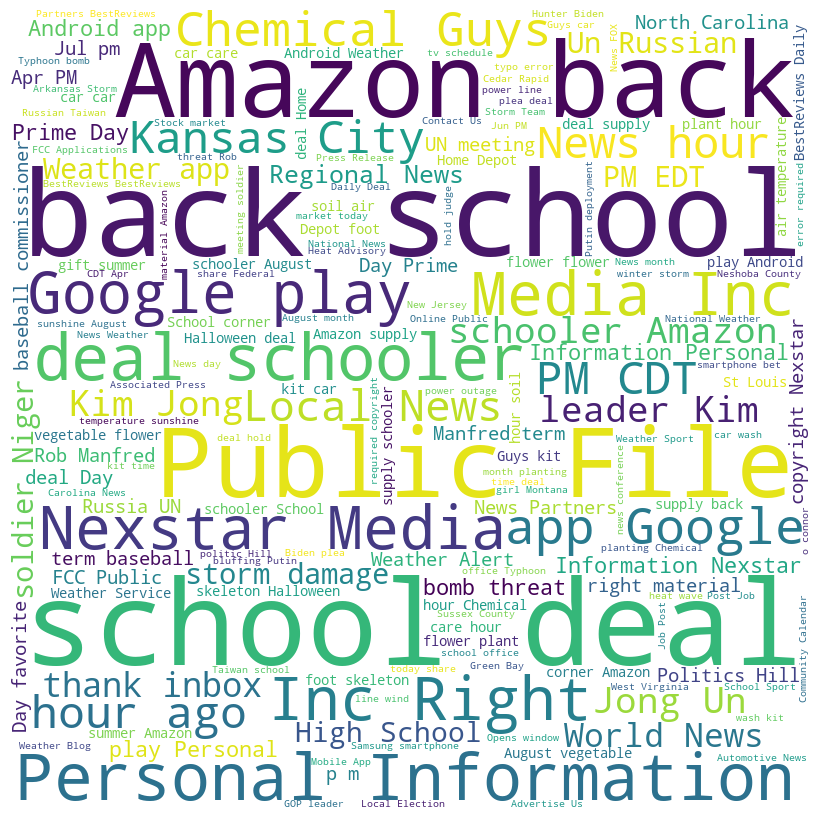

Cluster 19


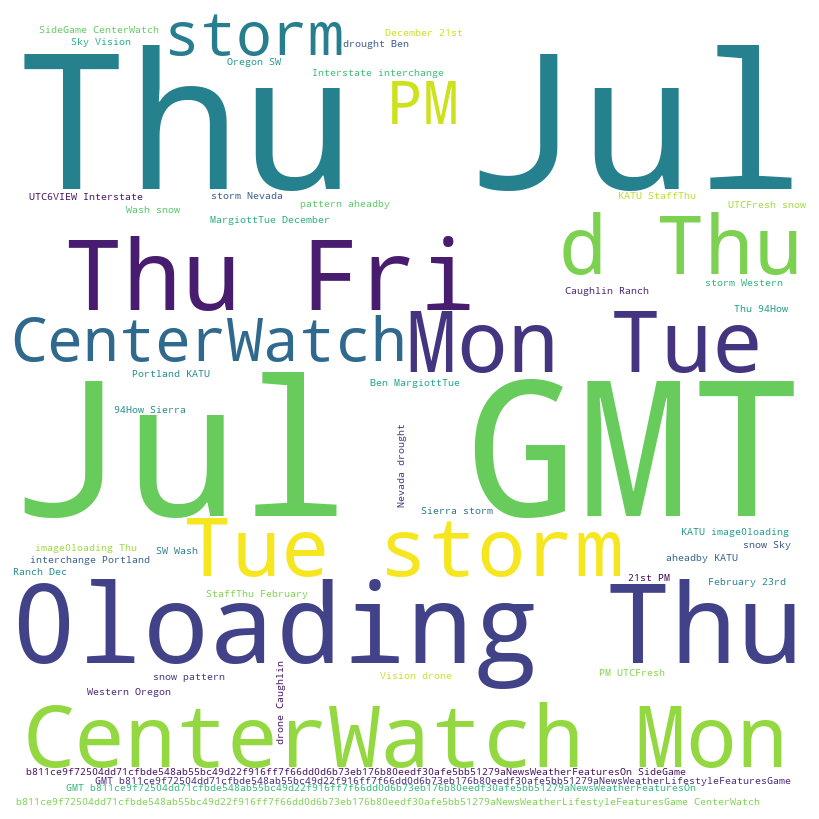

Cluster 20


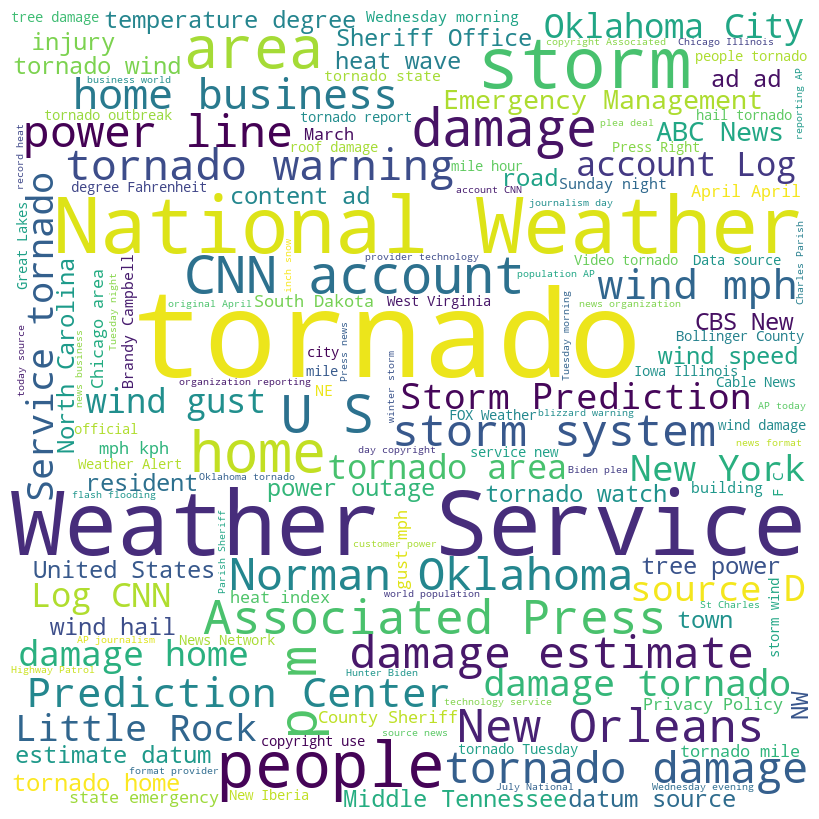

Cluster 21


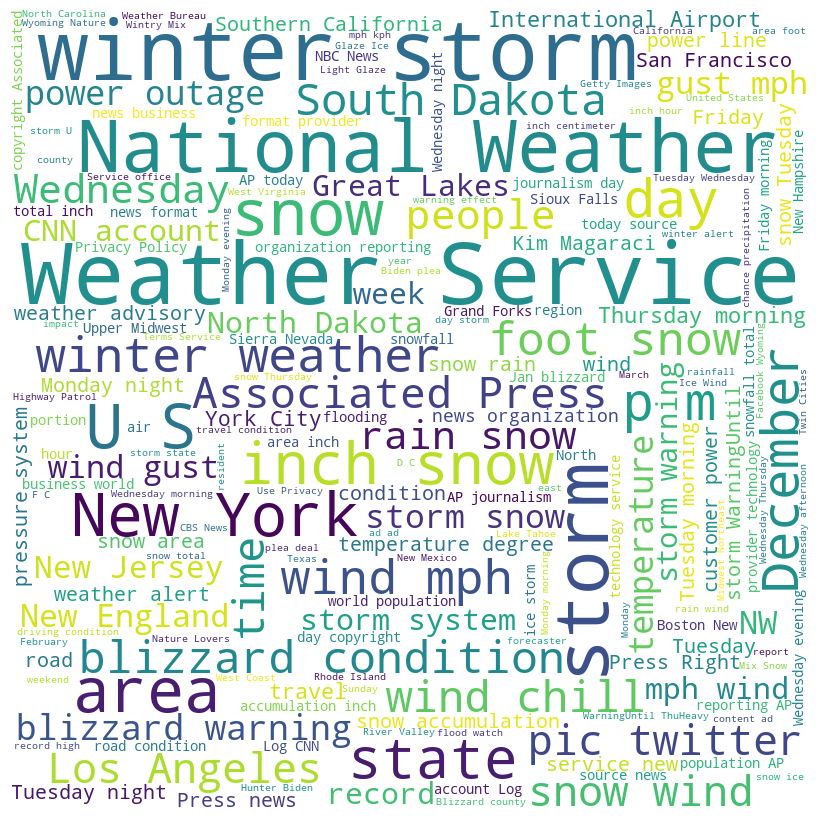

Cluster 22


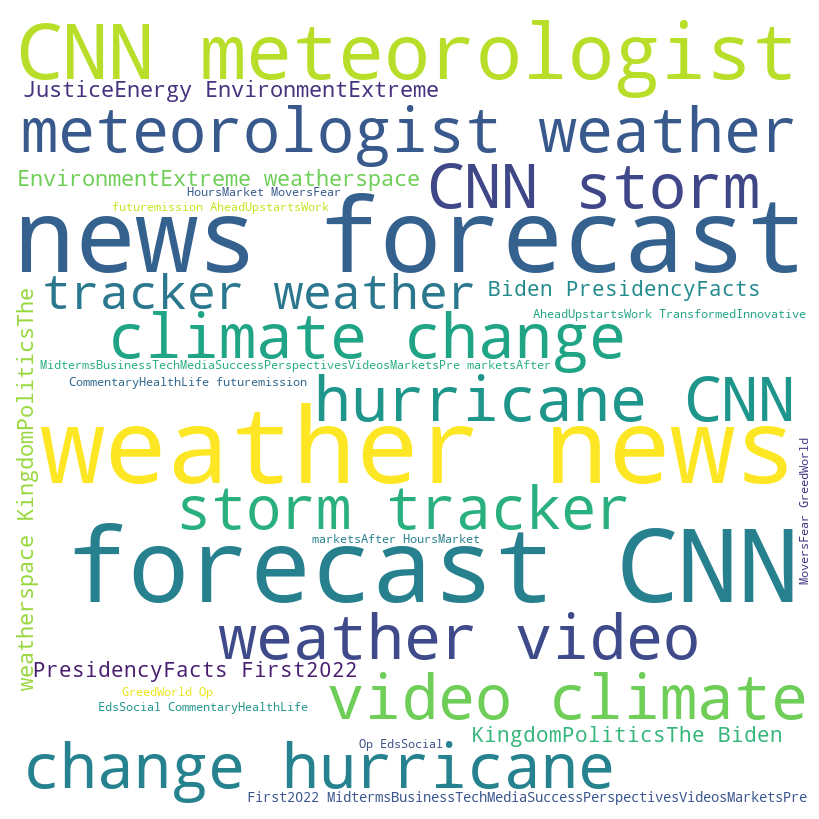

Cluster 23


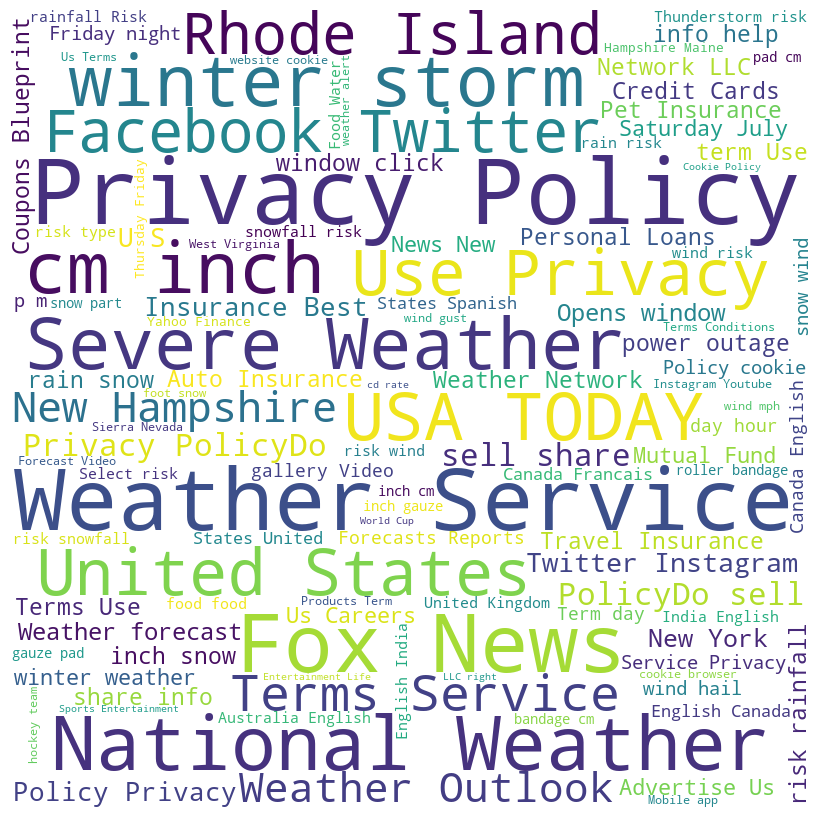

Cluster 24


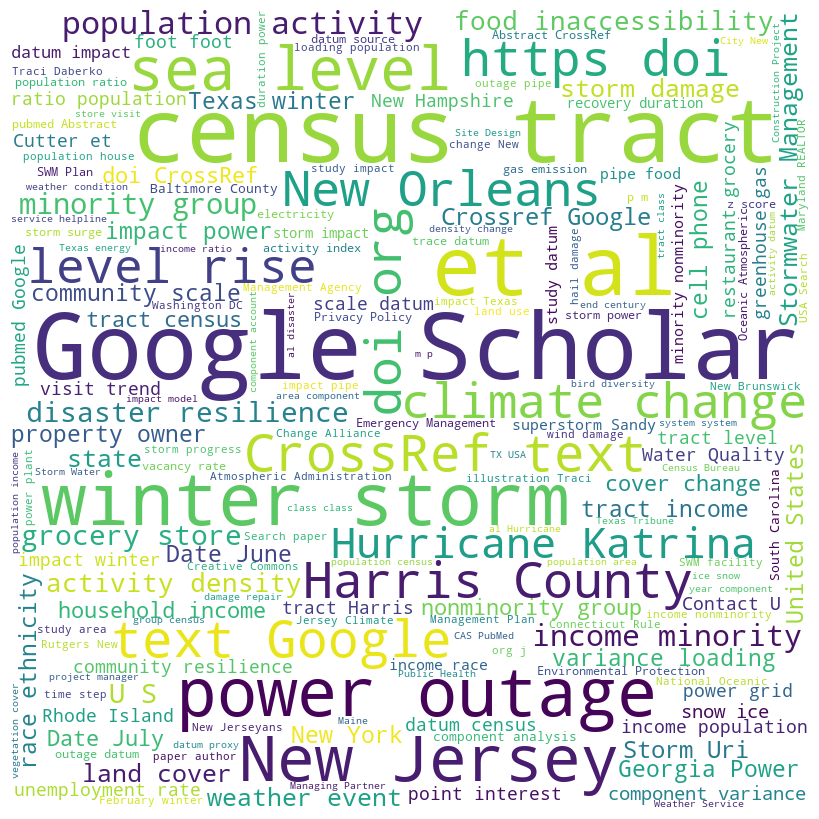

wordcloud done


,title,author,publication,body_text,url,state,nouns,adjetives,verbs,nav,lemmas,num_tokens,cluster_num
0,Tornadoes severe weather updates: 26 dead in M...,None,None,Start the day smarter How often do women givin...,https://www.usatoday.com/story/news/nation/202...,Mississippi,day|woman|birth|hospital|heart|attack|seizure|...,smart|individual|other|deadly|notable|severe|d...,start|do|give|experience|podcast|sell|topic'wi...,start|day|smart|do|woman|give|birth|individual...,start|the|day|smart|how|often|do|woman|give|bi...,2488.0,11.0
1,Fatality confirmed in Vermont flooding amid ex...,ABC News,None,ABC NewsVideoLiveShowsElectionsInterest Succe...,https://abcnews.go.com/US/tornadoes-midwest-fl...,Illinois,ABC|NewsVideoLiveShowsElectionsInterest|Succes...,aboutturn|extreme|nationwideExtreme|most|multi...,notify|break|confirm|flood|continue|affect|pas...,ABC|NewsVideoLiveShowsElectionsInterest|Succes...,|ABC|NewsVideoLiveShowsElectionsInterest|Succ...,998.0,20.0
2,Terrifying moment monster tornado rips apart A...,Aneeta Bhole,None,US women spark fury with ANOTHER listless rend...,https://www.dailymail.co.uk/news/article-11926...,Arkansas,US|woman|fury|rendition|Star|Spangled|Banner|W...,listless|other|new|devastated|second|irreconci...,spark|sing|wrap|file|feel|abandon|file|cite|be...,US|woman|spark|fury|listless|rendition|Star|Sp...,US|woman|spark|fury|with|another|listless|rend...,13383.0,14.0
3,Maryland weather: Storms cease Tuesday night a...,None,None,Close this dialog This website stores data suc...,https://www.baltimoresun.com/weather/bs-md-thu...,Maryland,dialog|website|datum|cookie|site|functionality...,such|essential|new|new|new|new|new|new|new|new...,close|store|enable|remain|indicate|services(op...,close|dialog|website|store|datum|such|cookie|e...,close|this|dialog|this|website|store|datum|suc...,928.0,3.0
4,"Wind, cold, and snow set to paralyze Iowa trav...",None,None,Election Results Streaming Iowa News Metro New...,https://who13.com/weather/winter-storm-targeti...,Iowa,election|result|Iowa|News|Metro|News|National|...,black|newborn|republican|ready|senior|cardiac|...,stream|vote|honor|accuse|drown|plead|arrest|as...,election|result|stream|Iowa|News|Metro|News|Na...,election|result|stream|Iowa|News|Metro|News|Na...,1601.0,18.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
4312,Winter Storm Approaching Idaho; Expert Boise S...,None,None,Skip to main contentSkip to site footerTrendin...,https://liteonline.com/major-winter-storm-appr...,Idaho,contentskip|footertrending|Great|Dolphin|DunkD...,main|significant|young|impossible|same|further...,skip|site|win|kanelistenlisten|livealexagoogle...,skip|main|contentskip|site|footertrending|Grea...,skip|to|main|contentskip|to|site|footertrendin...,1326.0,3.0
4313,New Mexico — Weather,None,None,"If you don't have an account yet, make one her...",https://www.iexplore.com/articles/travel-guide...,New Mexico,account|sign|Sign|Facebook|New|Mexico|land|cli...,high|dry|southern|warm|mild|daily|hot|dry|Most...,do|have|make|click|acknowledge|be|share|be|tra...,do|have|account|make|click|sign|Sign|Facebook|...,"if|you|do|not|have|an|account|yet|,|make|one|h...",474.0,17.0
4314,Colorado Climate | Articles | Colorado Encyclo...,None,None,Please enable JavaScript in your browser to en...,None,Colorado,JavaScript|browser|site|feature|image|map|time...,many|asian|political|religious|native|religiou...,enable|enable|include|result|invigorate|be|be|...,enable|JavaScript|browser|enable|many|site|fea...,please|enable|JavaScript|in|your|browser|to|en...,2053.0,17.0
4315,Snow maps: Massachusetts forecast for March 3-...,Dialynn Dwyer,None,Tell Us Readers Say Book Club Cocktail Club Th...,https://www.boston.com/weather/weather/2023/03...,Massachusetts,Us|reader|Say|Book|Club|Cocktail|Club|B|start|...,side|fresh|side|fresh|much|sloppy|immediate|wi...,tell|tell|map|expect|change|say|might|want|kee...,tell|Us|reader|Say|Book|Club|Cocktail|Club|B|s...,tell|Us|reader|Say|Book|Club|Cocktail|Club|th

In [216]:
# Set desired cluster number - can be changed at desired amount
cluster_num = 25

# Run main call - total average time is 
final_df, cluster_dict, doc_vecs, tfidf_vecs, w2v_vecs = run_program(cluster_num)
final_df

# END OF PART TWO